In [1]:
%load_ext autoreload
%autoreload 2


In [2]:
import ShallowLearn.LoadData as ld
import pkg_resources

In [3]:
from ShallowLearn.band_mapping import band_mapping
import ShallowLearn.ImageHelper as ih

In [4]:
from ShallowLearn import Indices

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [6]:
from ShallowLearn.IndiceFeatures import GenerateIndicesPerImage
from ShallowLearn.ImageHelper import load_img

In [7]:
import ShallowLearn.Transform as tf

In [8]:
import os
import glob

# specify the directory path
dir_path = '/media/ziad/Expansion/Cleaned_Data_Directory'

# search for all .tiff files in the directory
file_list = glob.glob(dir_path + '/*6880*.tiff')

# get the full directory paths for each file
dir_list = [os.path.join(dir_path, f) for f in file_list]



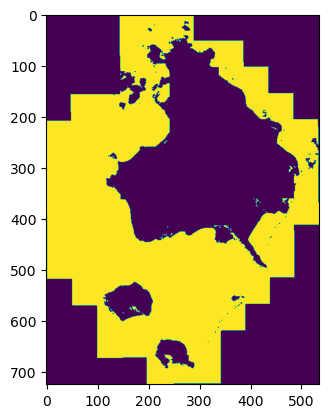

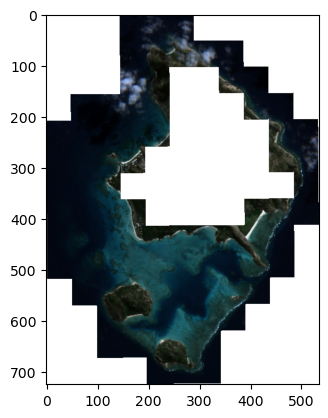

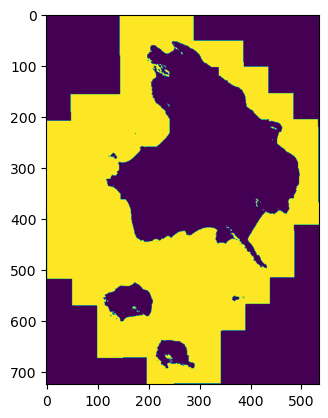

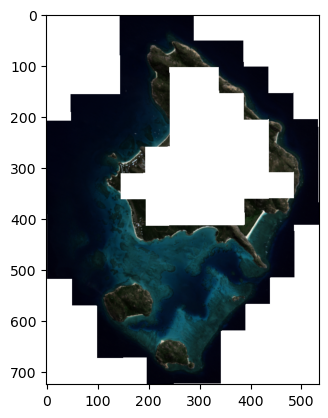

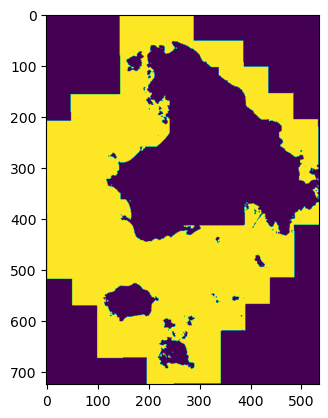

...

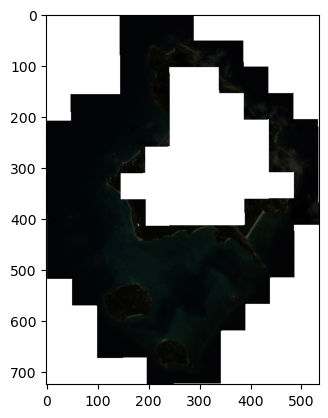

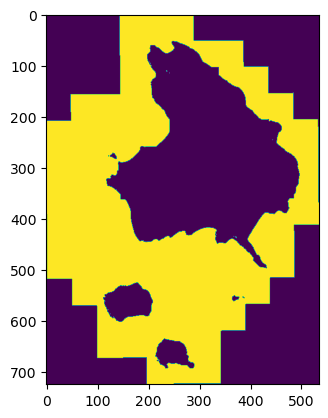

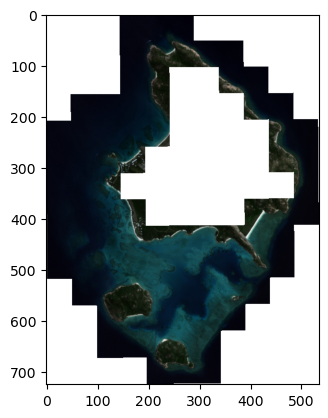

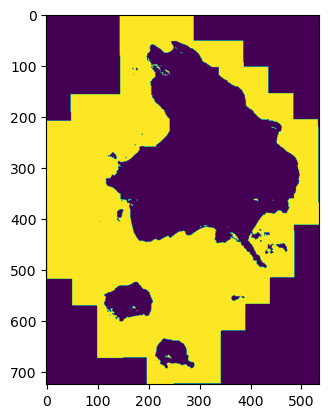

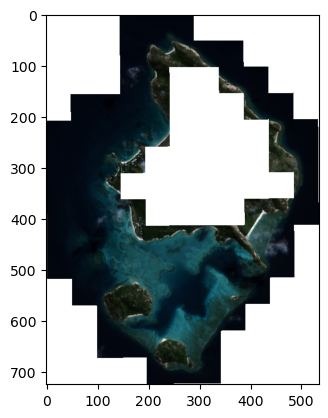

In [9]:
masks = []
good_imagery = []
for i in range(len(dir_list)):
    data = load_img(dir_list[i])
    #plt.imshow(data[:,:,7])
    mask = Indices.mask_land(tf.LCE_multi(data),land_band= 'B08', threshold=50)
    mean = (np.mean(mask))
    if np.mean(mask) < 0.6 and np.mean(mask) > 0.4:
        masks.append(mask)
        good_imagery.append(data)
        plt.imshow(~mask)
        plt.show()
        ih.plot_rgb(tf.LCE_multi(data), plot = True)
        plt.show()  

In [10]:
# data = ih.apply_mask(data, ~mask, fill_value=np.nan)
clipped_imagery = []
for img, mask in zip(good_imagery, masks):
    clipped_imagery.append((ih.apply_mask(img, ~mask, fill_value=np.nan)))

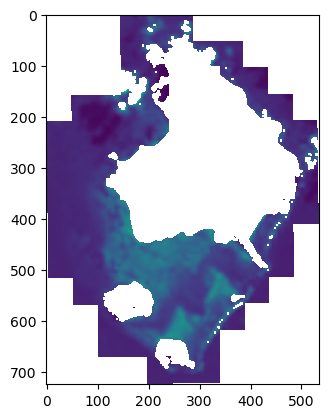

In [11]:
plt.imshow(clipped_imagery[0][:,:,0])

In [12]:

features = GenerateIndicesPerImage(data)


indice_stack = []
for img in clipped_imagery:
    features = GenerateIndicesPerImage(img)
    concated_array = np.concatenate((img, features.indices), axis = 2)
    indice_stack.append(concated_array)

[('bgr', <function bgr at 0x7f7ea917e710>), ('calculate_pseudo_subsurface_depth', <function calculate_pseudo_subsurface_depth at 0x7f7ea917e9e0>), ('calculate_subsurface_depth', <function calculate_subsurface_depth at 0x7f7ea917ea70>), ('calculate_water_surface_index', <function calculate_water_surface_index at 0x7f7ea917e950>), ('ci', <function ci at 0x7f7f0813f010>), ('get_band_numbers', <function get_band_numbers at 0x7f7ea917e830>), ('mask_land', <function mask_land at 0x7f7ea917e7a0>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917e440>), ('ssi', <function ssi at 0x7f7ea917e4d0>), ('ti', <function ti at 0x7f7ea917e560>), ('validate_band_shape', <function validate_band_shape at 0x7f7ea917e8c0>), ('wqi', <function wqi at 0x7f7ea917e5f0>)]
[('bgr', <function bgr at 0x7f7ea917e710>), ('ci', <function ci at 0x7f7f0813f010>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917e440>), ('ssi', <function ssi at 0x7f7ea917e4d0>)

/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:47: RuntimeWarning: invalid value encountered in divide
  ci = (nir_band - red_band) / (nir_band + red_band + red_edge_band)
/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:195: RuntimeWarning: invalid value encountered in divide
  ndci = (green_band - red_edge_band) / (green_band + red_edge_band) + 1
/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:105: RuntimeWarning: invalid value encountered in divide
  ssi = (nir_band - red_band) / (nir_band + red_band + red_edge_band)


['bgr', 'ci', 'ndci', 'oci', 'ssi', 'ti', 'wqi']
[('bgr', <function bgr at 0x7f7ea917e710>), ('calculate_pseudo_subsurface_depth', <function calculate_pseudo_subsurface_depth at 0x7f7ea917e9e0>), ('calculate_subsurface_depth', <function calculate_subsurface_depth at 0x7f7ea917ea70>), ('calculate_water_surface_index', <function calculate_water_surface_index at 0x7f7ea917e950>), ('ci', <function ci at 0x7f7f0813f010>), ('get_band_numbers', <function get_band_numbers at 0x7f7ea917e830>), ('mask_land', <function mask_land at 0x7f7ea917e7a0>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917e440>), ('ssi', <function ssi at 0x7f7ea917e4d0>), ('ti', <function ti at 0x7f7ea917e560>), ('validate_band_shape', <function validate_band_shape at 0x7f7ea917e8c0>), ('wqi', <function wqi at 0x7f7ea917e5f0>)]
[('bgr', <function bgr at 0x7f7ea917e710>), ('ci', <function ci at 0x7f7f0813f010>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917

In [13]:
features.indice_order

['bgr', 'ci', 'ndci', 'oci', 'ssi', 'ti', 'wqi']

In [14]:
features.indices.shape

(725, 534, 7)

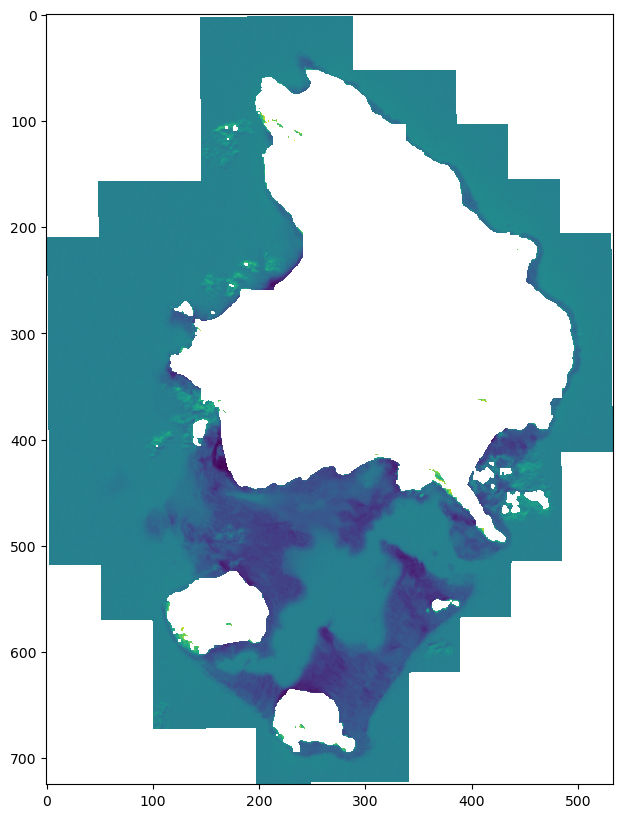

In [15]:
# make a figure that is 10 by 10 
fig = plt.figure(figsize=(10,10))
plt.imshow(features.indices[:,:,1])

In [16]:
X_train = np.array(indice_stack).reshape(-1, 20)

In [17]:
X_train

array([[nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       ...,
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan]])

In [18]:
from ShallowLearn.band_mapping import band_mapping

In [19]:
feature_names = list(band_mapping.keys()) + features.indice_order  

In [20]:
X_train = pd.DataFrame(X_train, columns = feature_names)

In [21]:
X_train = X_train.dropna().drop_duplicates()

In [22]:
X_train

,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B10,B11,B12,bgr,ci,ndci,oci,ssi,ti,wqi
722,1462.0,1057.0,626.0,369.0,361.0,345.0,358.0,248.0,74.0,7.0,260.0,251.0,373.0,1.688498,-0.123722,1.268490,0.678284,-0.123722,-0.195793,425.25
723,1453.0,1038.0,618.0,377.0,340.0,315.0,320.0,228.0,70.0,6.0,220.0,202.0,324.0,1.679612,-0.157672,1.290188,0.907407,-0.157672,-0.245875,412.50
724,1448.0,1053.0,633.0,383.0,353.0,335.0,338.0,230.0,69.0,6.0,212.0,193.0,307.0,1.663507,-0.158385,1.283976,1.061889,-0.158385,-0.249186,426.00
725,1451.0,1048.0,620.0,388.0,349.0,330.0,333.0,209.0,69.0,6.0,200.0,184.0,297.0,1.690323,-0.189218,1.279670,1.087542,-0.189218,-0.299331,421.75
726,1460.0,1050.0,622.0,365.0,327.0,302.0,305.0,209.0,71.0,6.0,183.0,177.0,296.0,1.688103,-0.173141,1.310854,1.101351,-0.173141,-0.271304,404.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20518661,2300.0,1960.0,1579.0,1305.0,1255.0,1232.0,1212.0,1176.0,1056.0,1009.0,1073.0,1053.0,1184.0,1.241292,-0.034529,1.114326,0.333615,-0.034529,-0.051974,1342.75
20518662,2300.0,1965.0,1583.0,1317.0,1254.0,1233.0,1211.0,1184.0,1057.0,1009.0,1072.0,1057.0,1179.0,1.241314,-0.035419,1.115968,0.342663,-0.035419,-0.053157,1346.75
20518663,2300.0,1958.0,1581.0,1322.0,1254.0,1234.0,1212.0,1180.0,1057.0,1009.0,1073.0,1057.0,1179.0,1.238457,-0.037806,1.115344,0.340967,-0.037806,-0.056732,1347.75
20518664,2300.0,1961.0,1585.0,1321.0,1257.0,1234.0,1216.0,1178.0,1057.0,1009.0,1075.0,1053.0,1183.0,1.237224,-0.038072,1.115412,0.339814,-0.038072,-0.057200,1349.25


In [23]:
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.model_selection import GridSearchCV
from sklearn.mixture import GaussianMixture

In [24]:
def plot_histograms(dataframe):

    columns = dataframe.columns
    for column in columns:
        sns.histplot(dataframe[column], kde = True)
        plt.title(column)
        plt.show()

In [25]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer

In [26]:
from sklearn import decomposition
import matplotlib.pyplot as plt

In [27]:
sd = (X_train.sample(250_000, random_state = 42))


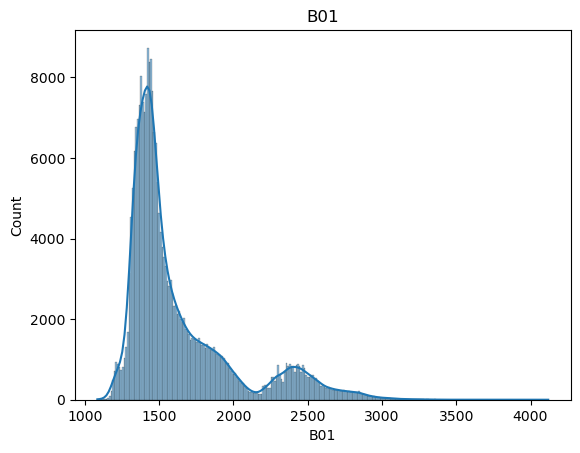

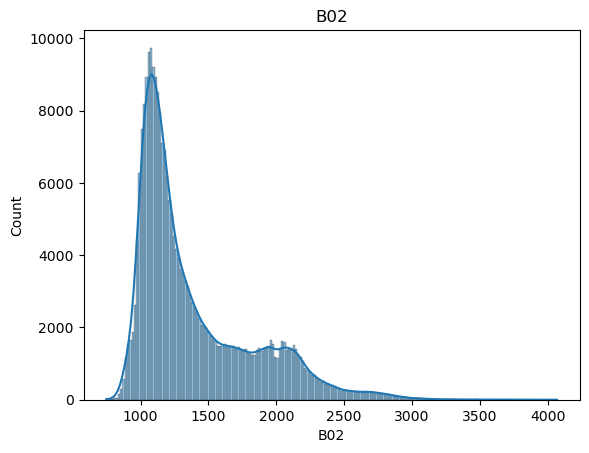

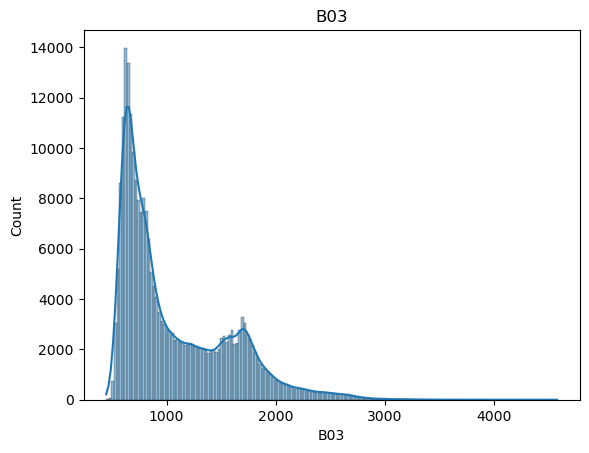

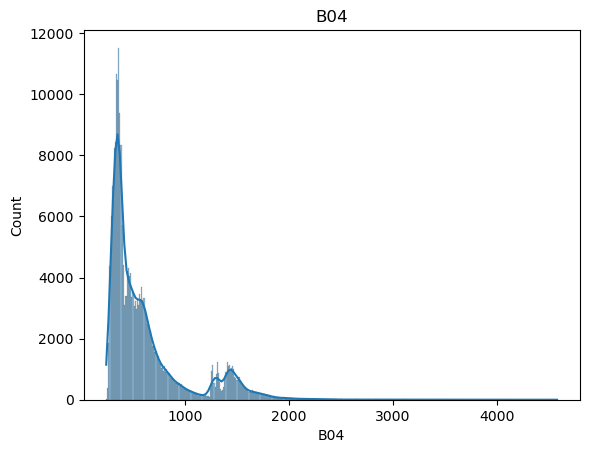

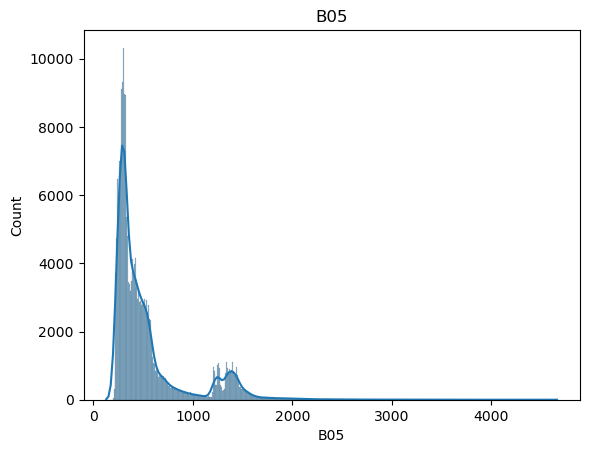

...

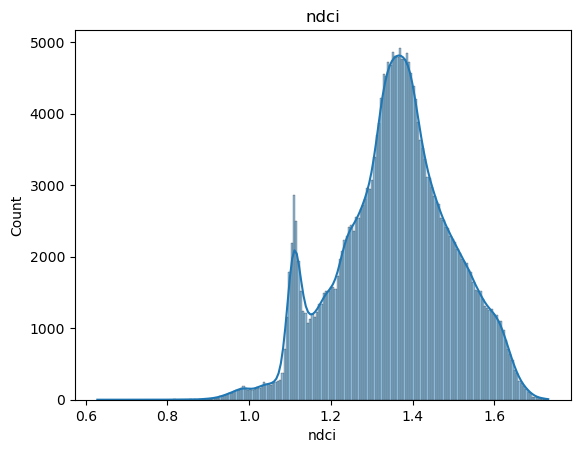

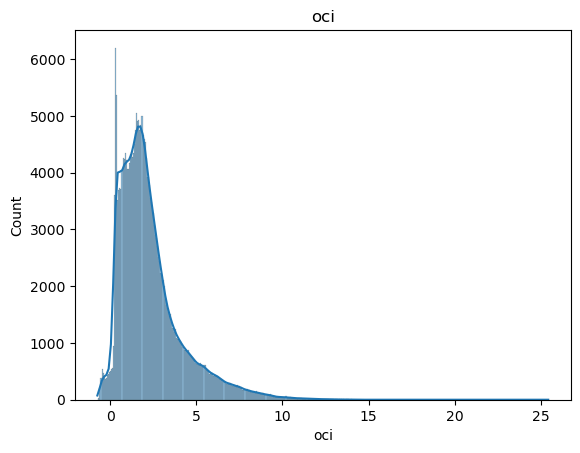

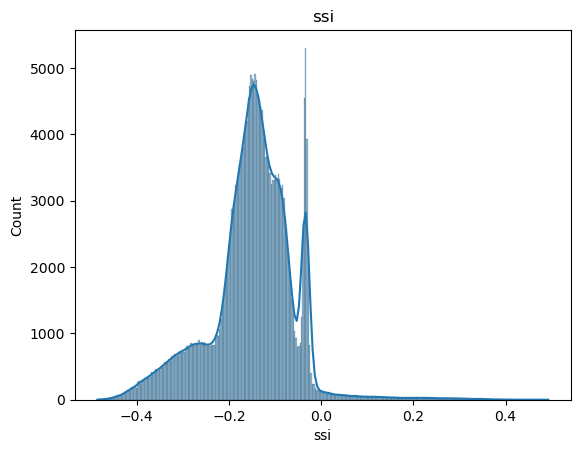

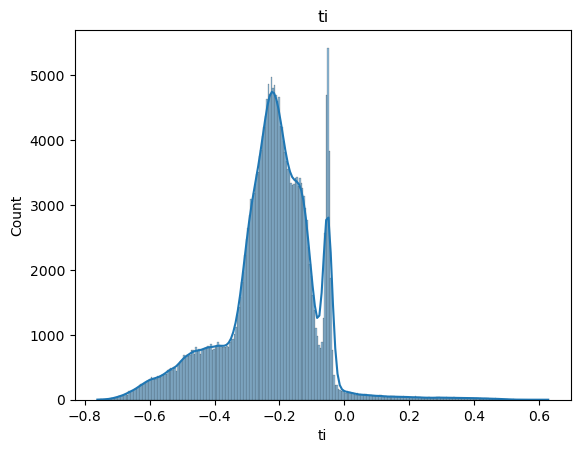

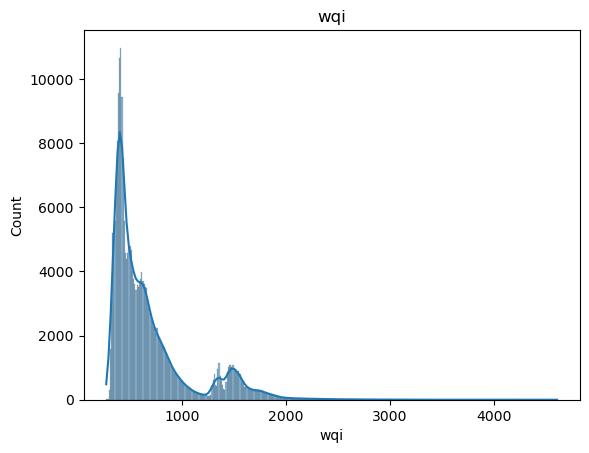

In [28]:
plot_histograms(sd)

In [29]:
pt = PowerTransformer()

In [30]:
sd = pd.DataFrame(pt.fit_transform(sd), columns = sd.columns)

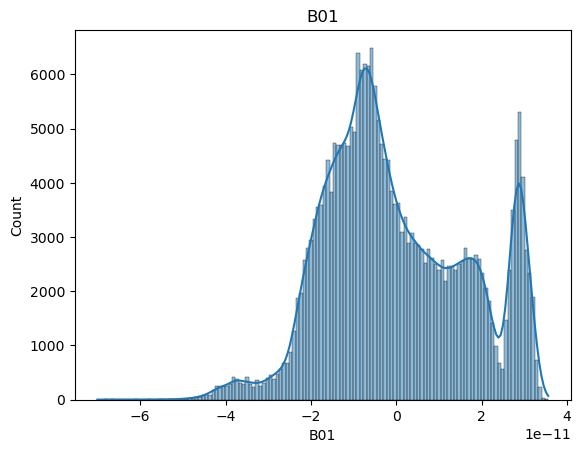

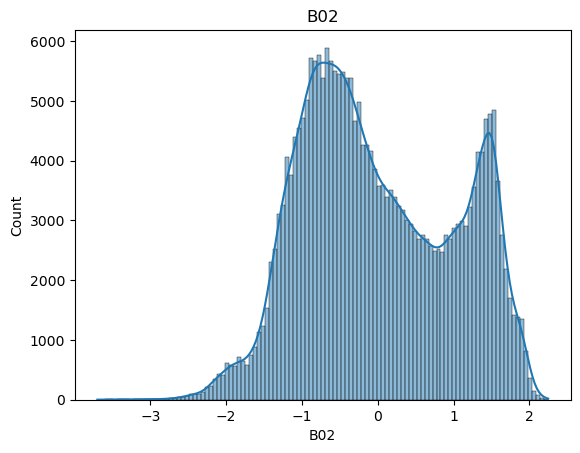

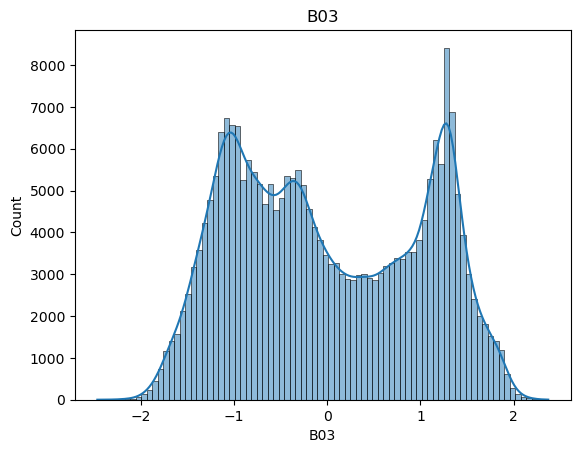

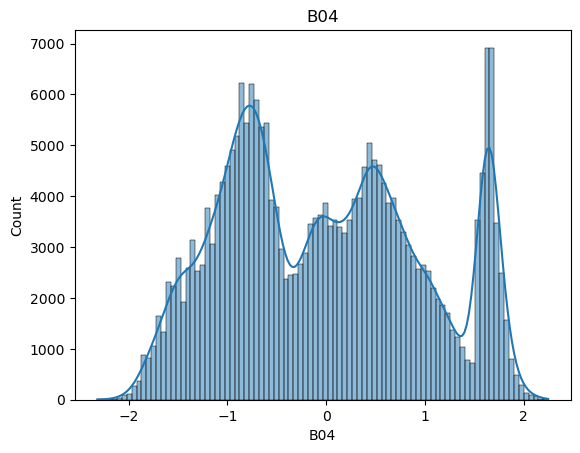

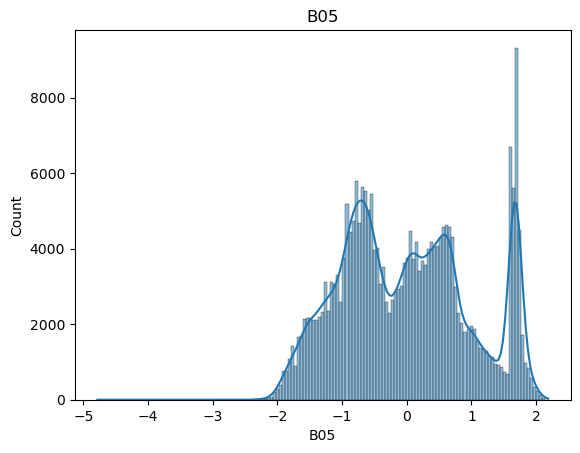

...

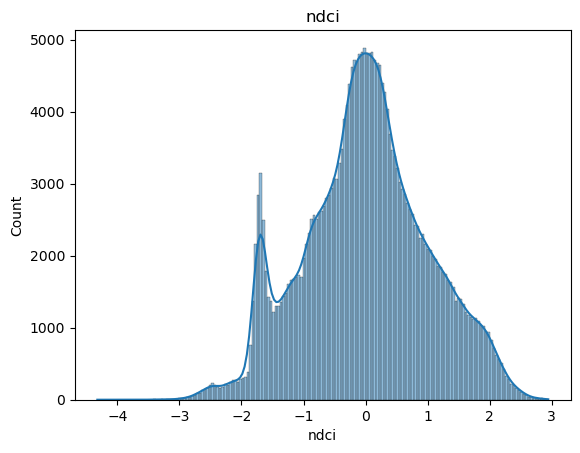

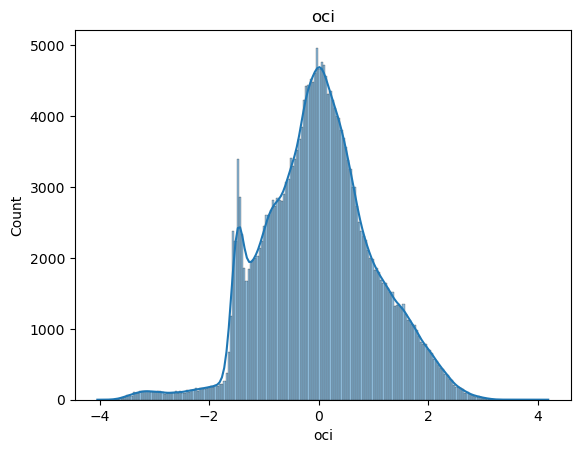

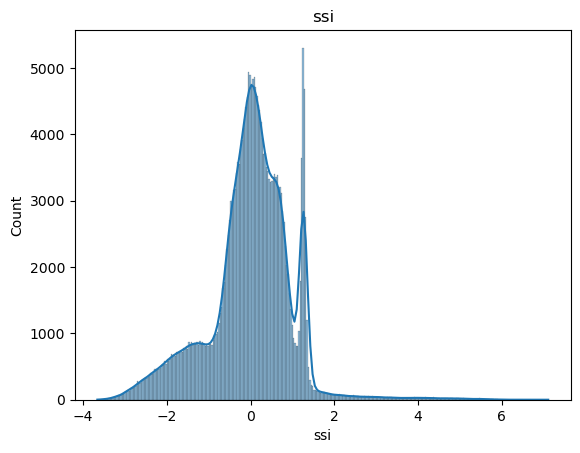

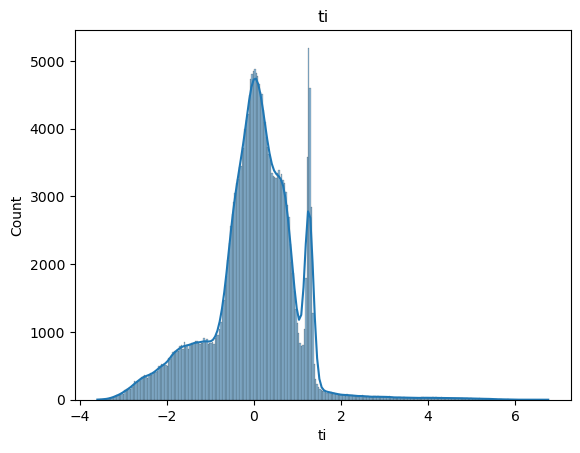

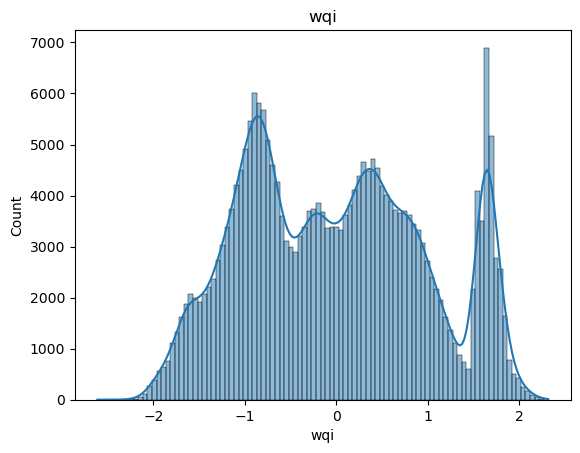

In [31]:
plot_histograms(sd)

In [32]:
scaler = StandardScaler()

In [33]:
rs = scaler.fit_transform(sd)

In [34]:
rs = pd.DataFrame(rs, columns = X_train.columns)

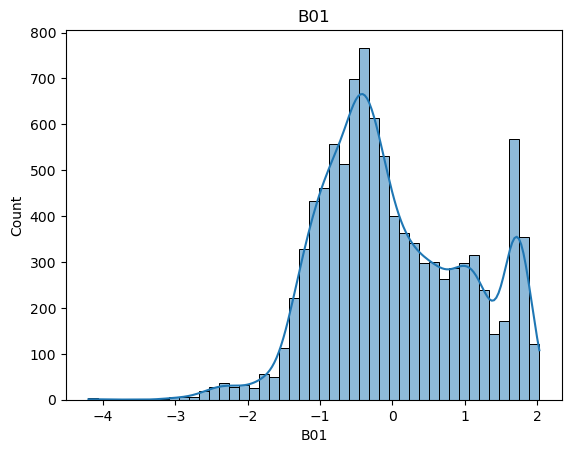

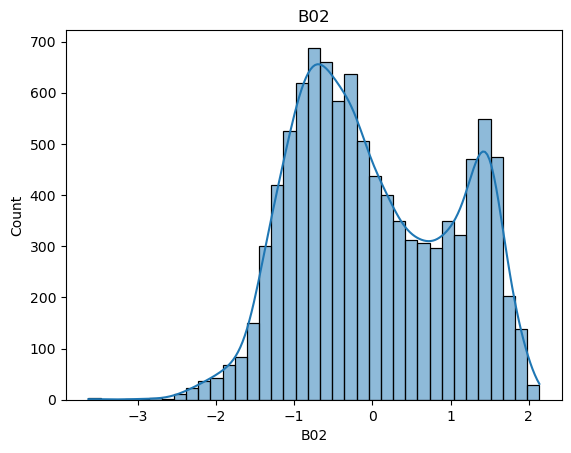

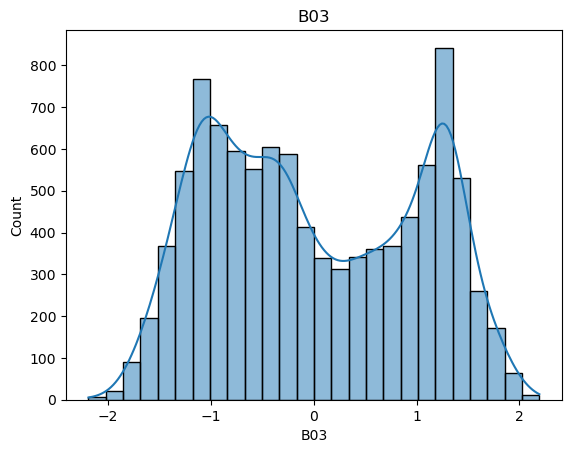

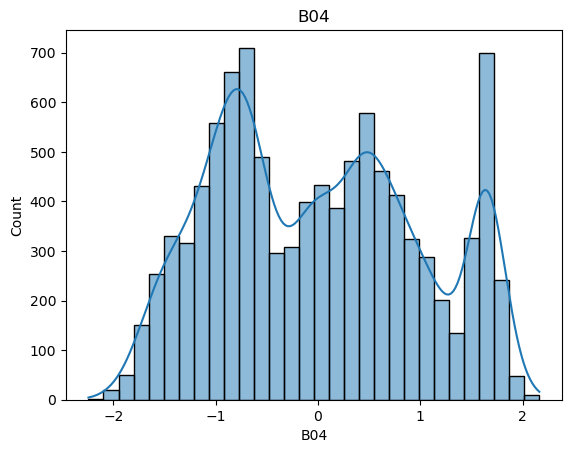

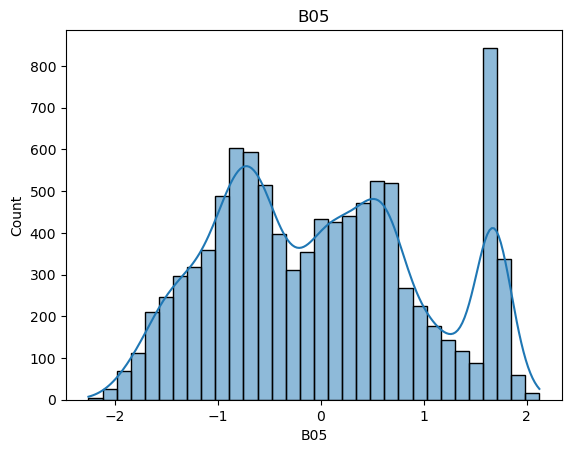

...

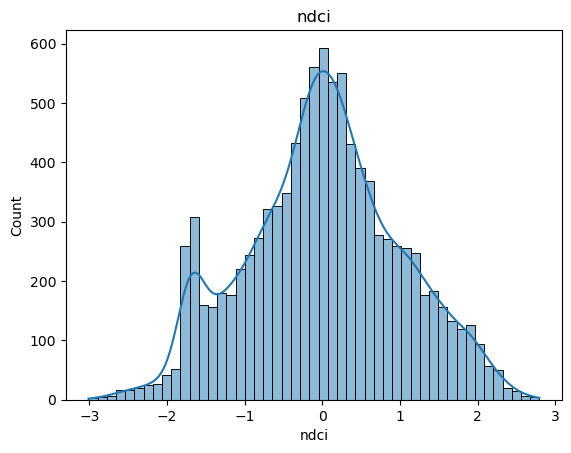

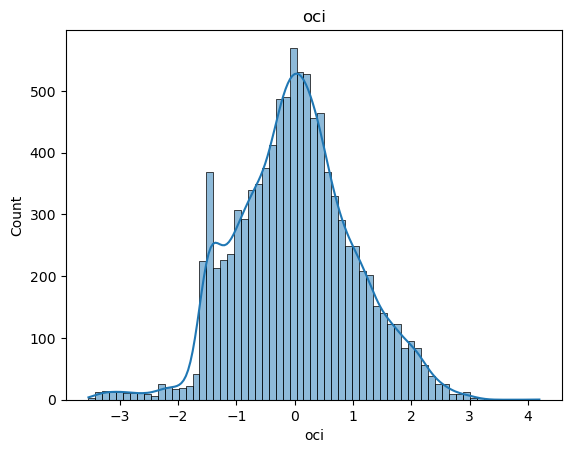

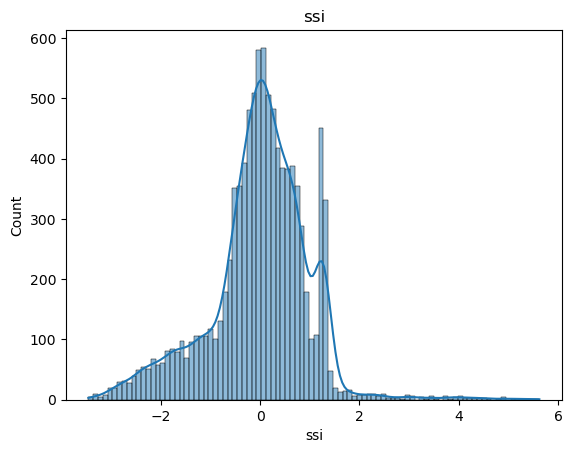

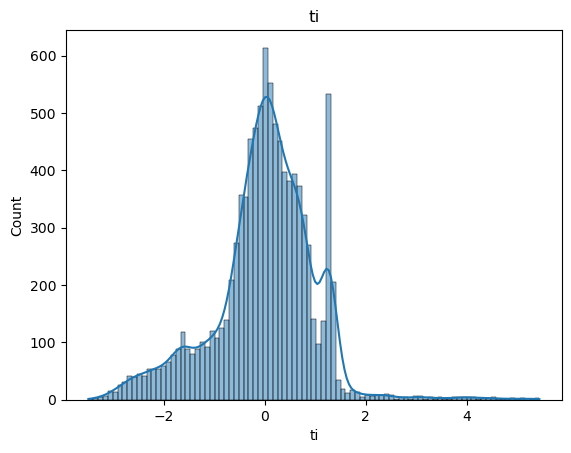

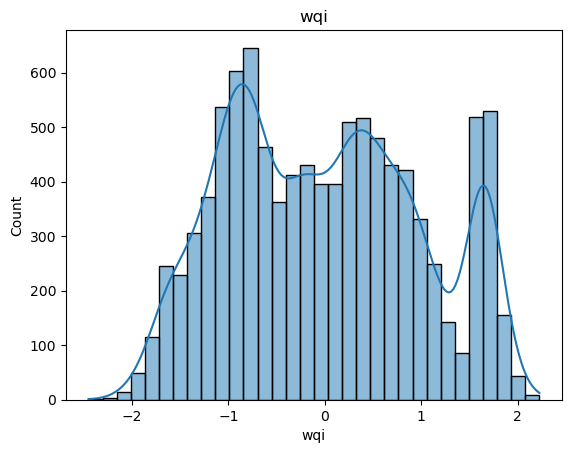

In [35]:
plot_histograms(rs.sample(10_000, random_state = 42))

In [36]:
pixel_df = X_train
pixel_df = pd.DataFrame(pixel_df, columns = X_train.columns)
sample_data = pixel_df.sample(100_000, random_state = 42)
pca = decomposition.PCA(n_components = 5, random_state = 42)
pca_data = pca.fit_transform(sample_data)

# pd.DataFrame(pca_data).plot.scatter(x = 0, y = 1)

In [37]:
pca.explained_variance_ratio_

array([0.8608452 , 0.09907338, 0.02271784, 0.00814489, 0.00381842])

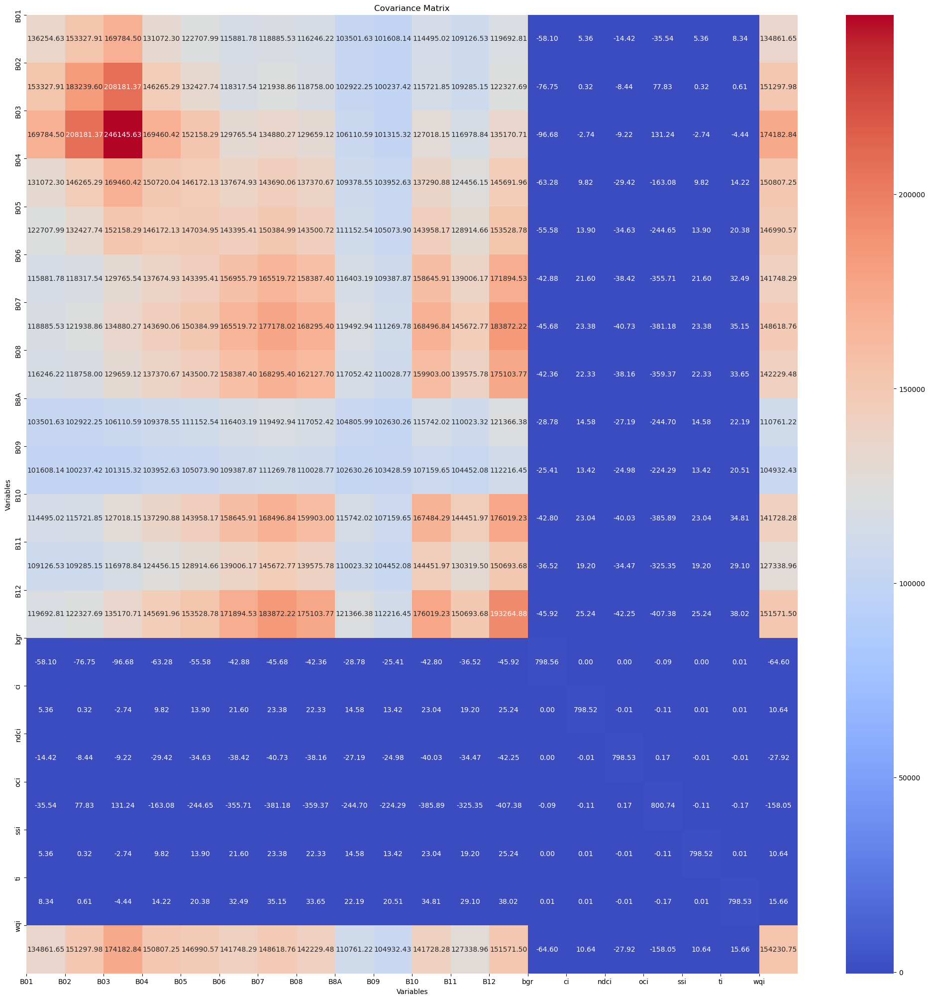

In [38]:
plt.figure(figsize=(25,25))
sns.heatmap(pca.get_covariance(),  annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Covariance Matrix")
plt.xlabel("Variables")
plt.ylabel("Variables")
plt.xticks(range(len(X_train.columns)), X_train.columns)
plt.yticks(range(len(X_train.columns)), X_train.columns)
plt.show()

In [39]:
classes = 10

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


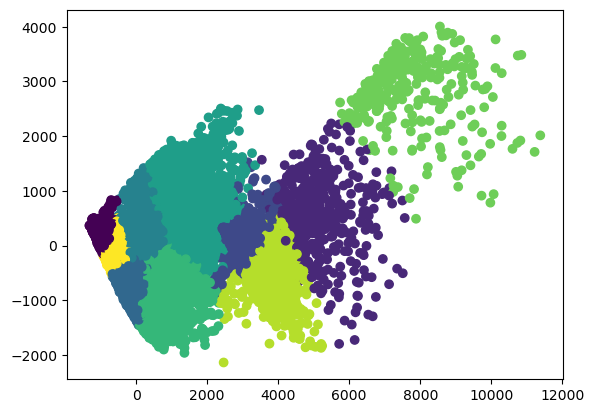

In [40]:
kmeans = KMeans(n_clusters=classes, random_state=42)
kmeans.fit(pca_data)
labels = kmeans.labels_

# Plot the reduced data and color it by the cluster labels
plt.scatter(pca_data[:, 0], pca_data[:, 1], c=labels)
plt.show()

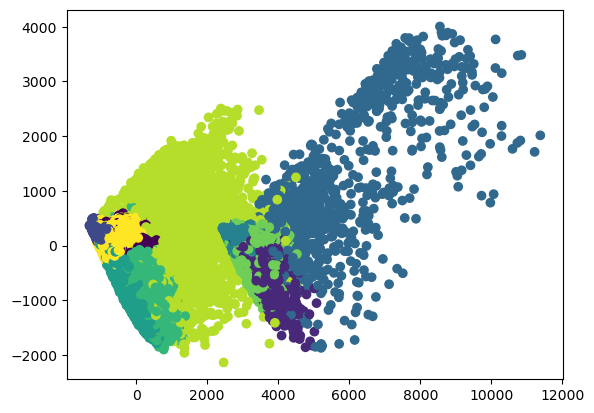

In [41]:
gm = GaussianMixture(n_components=classes, random_state=42)
gm.fit(pca_data)
labels = gm.predict(pca_data)

# Plot the reduced data and color it by the cluster labels
plt.scatter(pca_data[:, 0], pca_data[:, 1], c=labels)
plt.show()

In [42]:
import umap

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-

In [43]:
#q how do you determine the number of neighbors for umap?
#a the optimal number 

In [44]:
reducer = umap.UMAP(min_dist = 0.5, n_neighbors = 50 , random_state = 42, metric = 'correlation')

In [45]:
embedding = reducer.fit_transform(pca_data)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [46]:
from mpl_toolkits.mplot3d import Axes3D

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


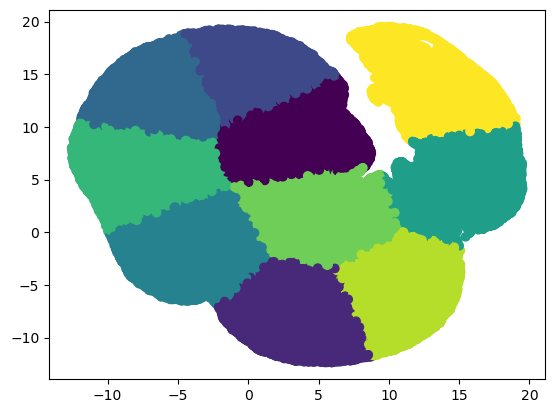

In [47]:
kmeans = KMeans(n_clusters=classes, random_state=42)
kmeans.fit(embedding)
labels = kmeans.labels_

# Plot the reduced data and color it by the cluster labels
plt.scatter(embedding[:, 0], embedding[:, 1], c=labels)
plt.show()

In [48]:
%matplotlib inline

In [49]:
sd.columns

Index(['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09',
       'B10', 'B11', 'B12', 'bgr', 'ci', 'ndci', 'oci', 'ssi', 'ti', 'wqi'],
      dtype='object')

In [50]:
sd_copy = sd.copy()

In [51]:
drop_cols = ['B12','B10','B09','B8A','B08','ti']

In [52]:
sd.drop(drop_cols, axis = 1, inplace = True)

In [53]:
sample_data.drop(drop_cols, axis = 1, inplace = True)

In [54]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split

In [55]:
X_train, X_test, y_train, y_test = train_test_split(sample_data,labels, test_size=.2)

In [56]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score

In [57]:

# Create a logistic regression object
logreg = LogisticRegression(max_iter = 1000, random_state=42)

# Train the model on the training data
logreg.fit(X_train, y_train)

# Predict the labels of the test data
y_pred = logreg.predict(X_test)

# Calculate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.74135


/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [58]:
preds = logreg.predict_proba(X_test)

In [59]:
roc_auc_score(y_test,preds, multi_class='ovo', average='macro')

0.9729533203735403

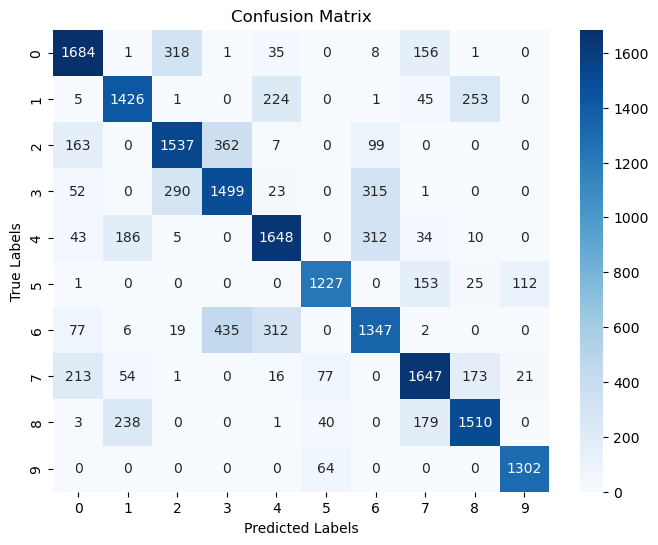

In [60]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


In [61]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Calculate the metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='macro')
recall = recall_score(y_test, y_pred, average='macro')
f1 = f1_score(y_test, y_pred, average='macro')
auc_roc = roc_auc_score(y_test, preds,  multi_class='ovo', average='macro')

# Print the metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 score:", f1)
print("AUC-ROC:", auc_roc)

Accuracy: 0.74135
Precision: 0.7519844047210548
Recall: 0.7514754974523505
F1 score: 0.7514442318136785
AUC-ROC: 0.9729533203735403


In [62]:
features = X_train.columns

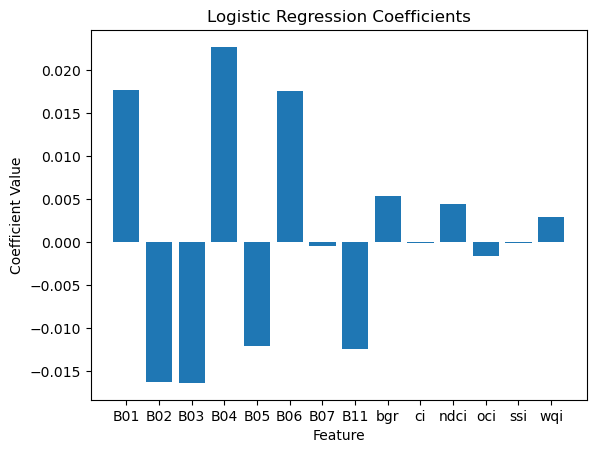

In [63]:
coef = logreg.coef_

plt.bar(range(len(coef[0])), coef[0])
plt.xticks(range(len(coef[0])), features)
plt.title("Logistic Regression Coefficients")
plt.xlabel("Feature")
plt.ylabel("Coefficient Value")
plt.show()

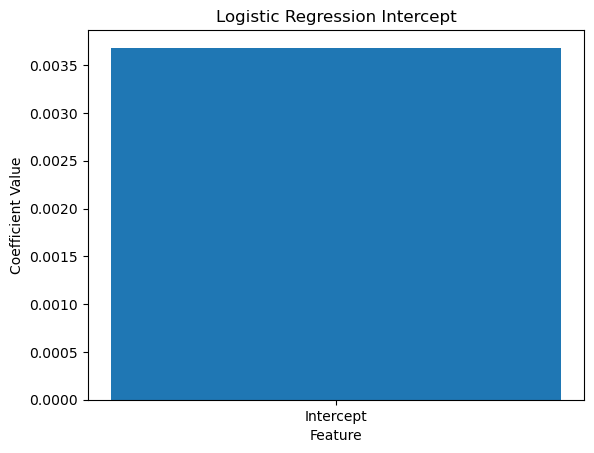

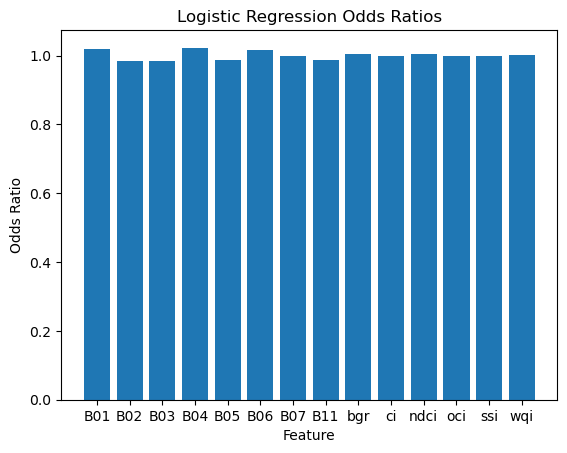

In [64]:
# Get the coefficients of the logistic regression model
coef = logreg.coef_[0]

# Get the intercept of the logistic regression model
intercept = logreg.intercept_[0]

# Calculate the odds ratios
odds_ratios = np.exp(coef)

# Plot the intercept
plt.bar(['Intercept'], [intercept])
plt.title("Logistic Regression Intercept")
plt.xlabel("Feature")
plt.ylabel("Coefficient Value")
plt.show()

# Plot the odds ratios
plt.bar(features, odds_ratios)
plt.title("Logistic Regression Odds Ratios")
plt.xlabel("Feature")
plt.ylabel("Odds Ratio")
plt.show()

In [65]:
bst = XGBClassifier(n_estimators=5, max_depth=8, learning_rate=1, objective='multi:softmax', num_class=len(np.unique(labels)))

In [66]:
bst.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=1, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=8, max_leaves=0, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=5, n_jobs=0, num_class=10,
              num_parallel_tree=1, objective='multi:softmax', ...)

In [67]:
preds = bst.predict(X_test)

In [68]:
preds = bst.predict_proba(X_test)

In [69]:
roc_auc_score(y_test,preds, multi_class='ovo', average='macro')

0.9981310801451081

In [70]:
feature_names

['B01',
 'B02',
 'B03',
 'B04',
 'B05',
 'B06',
 'B07',
 'B08',
 'B8A',
 'B09',
 'B10',
 'B11',
 'B12',
 'bgr',
 'ci',
 'ndci',
 'oci',
 'ssi',
 'ti',
 'wqi']

<Axes: >

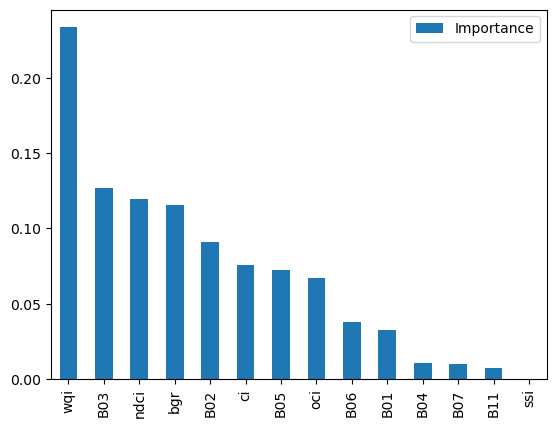

In [71]:
pd.DataFrame(bst.feature_importances_, columns = ['Importance'], index = sample_data.columns).sort_values(by = 'Importance', ascending = False).plot(kind = 'bar')

In [72]:
preds = bst.predict(X_test)

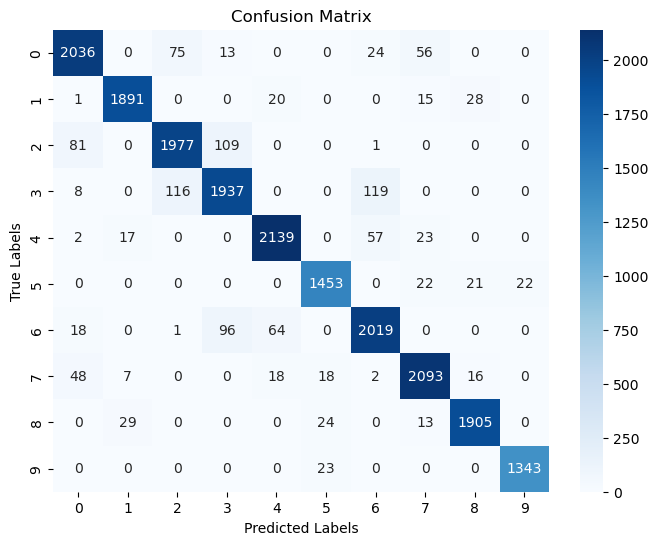

In [73]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


In [74]:
def scale_prop(arr):
    return scaler.fit_transform((pt.transform(arr)))


In [75]:
def reshape_stack(img):
    original_shape = img.shape
    test_data = pd.DataFrame(img.reshape(-1, 20), columns = feature_names)
    test_data = pd.DataFrame(scale_prop(test_data), columns = feature_names).drop(drop_cols, axis = 1)
    return test_data, original_shape


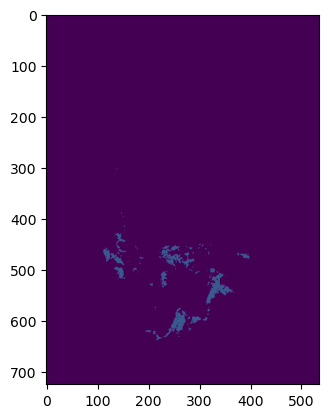

In [76]:
test_data, original_shape = reshape_stack(indice_stack[0])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

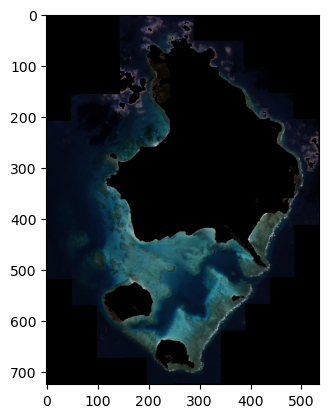

In [77]:
ih.plot_rgb(indice_stack[0], plot= True)

In [78]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))

<Axes: ylabel='Frequency'>

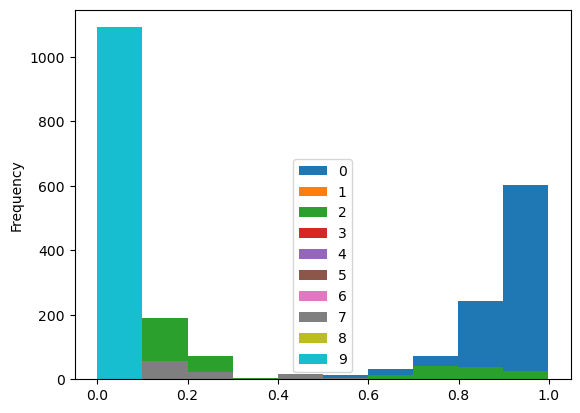

In [79]:
pd.DataFrame(proba_.reshape(-1, classes), columns = range(classes)).drop_duplicates().plot(kind = 'hist')

In [80]:
#plot_histograms(pd.DataFrame(proba_.reshape(-1, classes), columns = range(classes)))

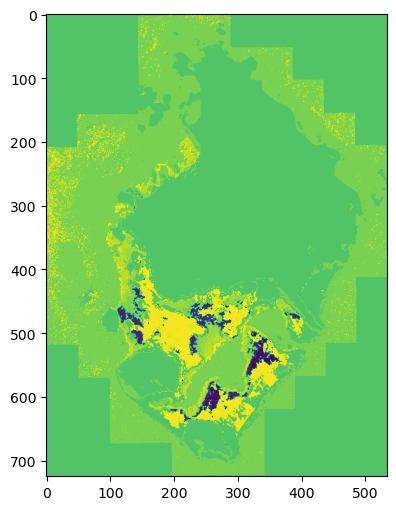

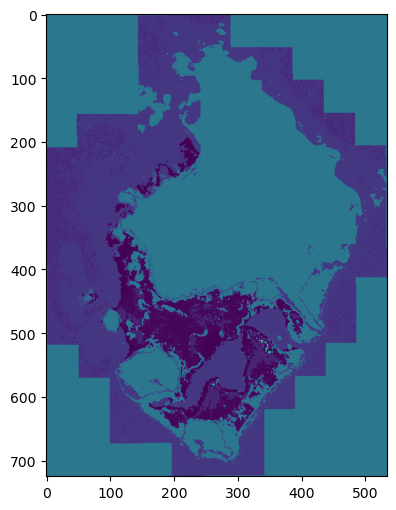

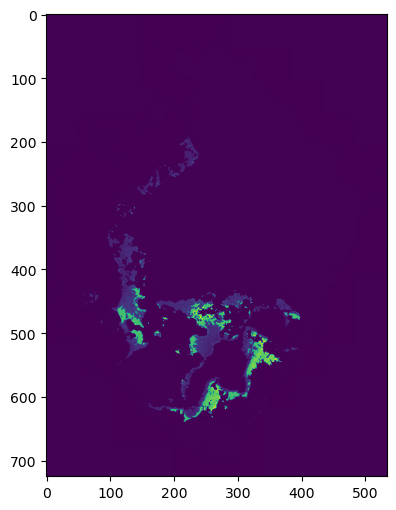

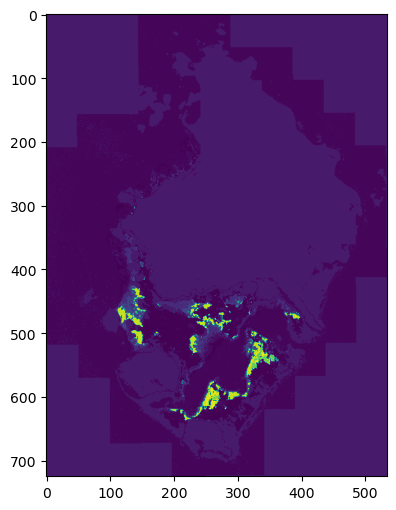

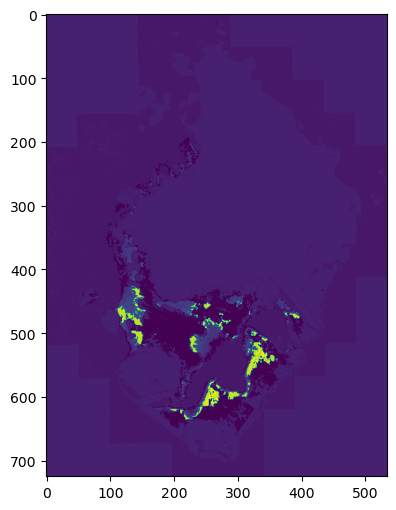

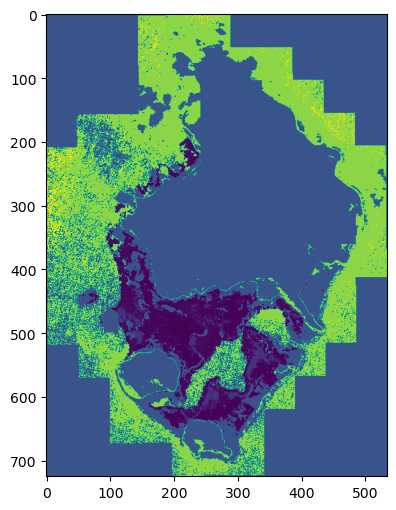

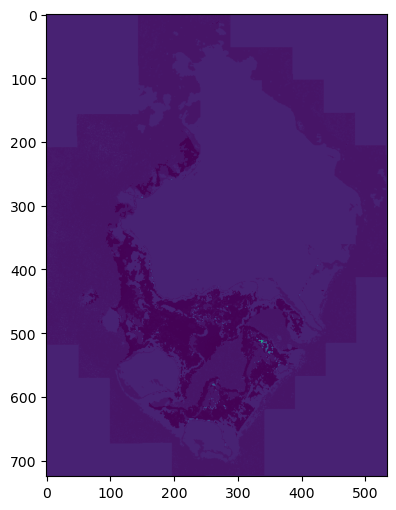

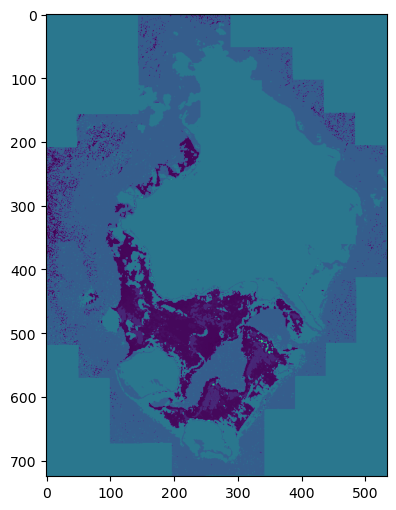

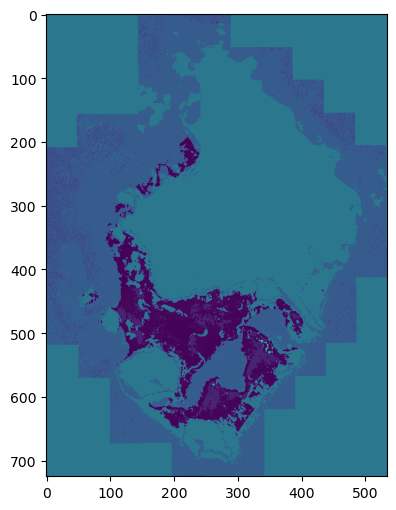

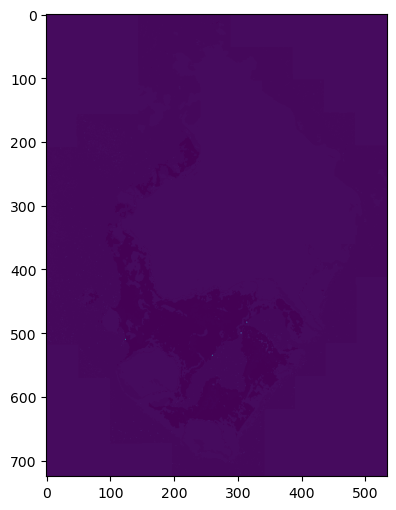

In [81]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))
for i in range(classes):
    plt.figure(figsize=(8, 6))
    plt.imshow(proba_[:,:,i])
    plt.show()

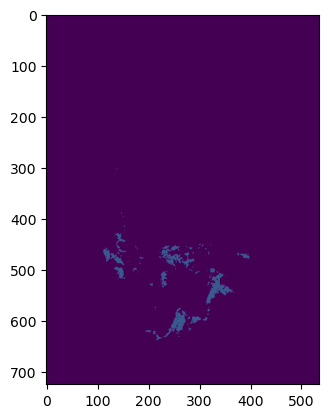

In [82]:
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

In [83]:
indice_stack[3].shape

(725, 534, 20)

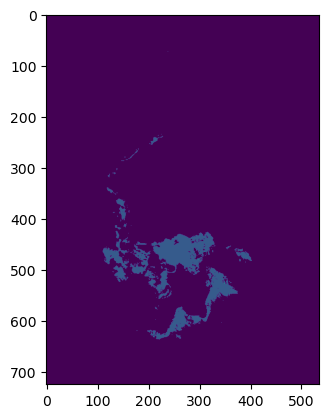

In [84]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

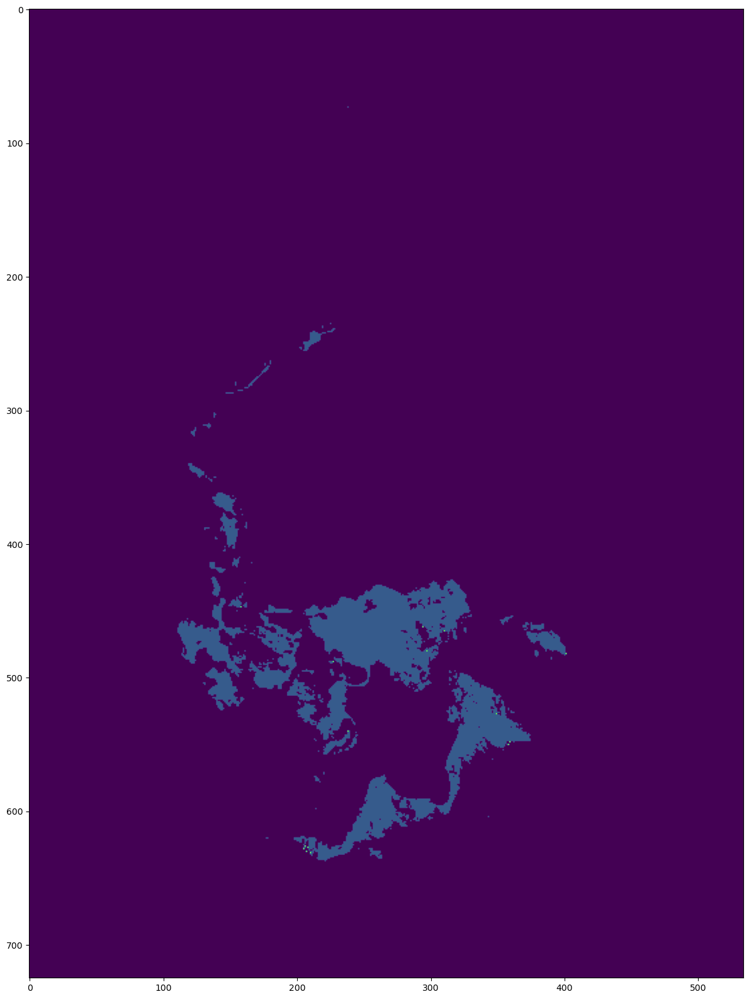

In [85]:
plt.figure(figsize=(20,20))
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

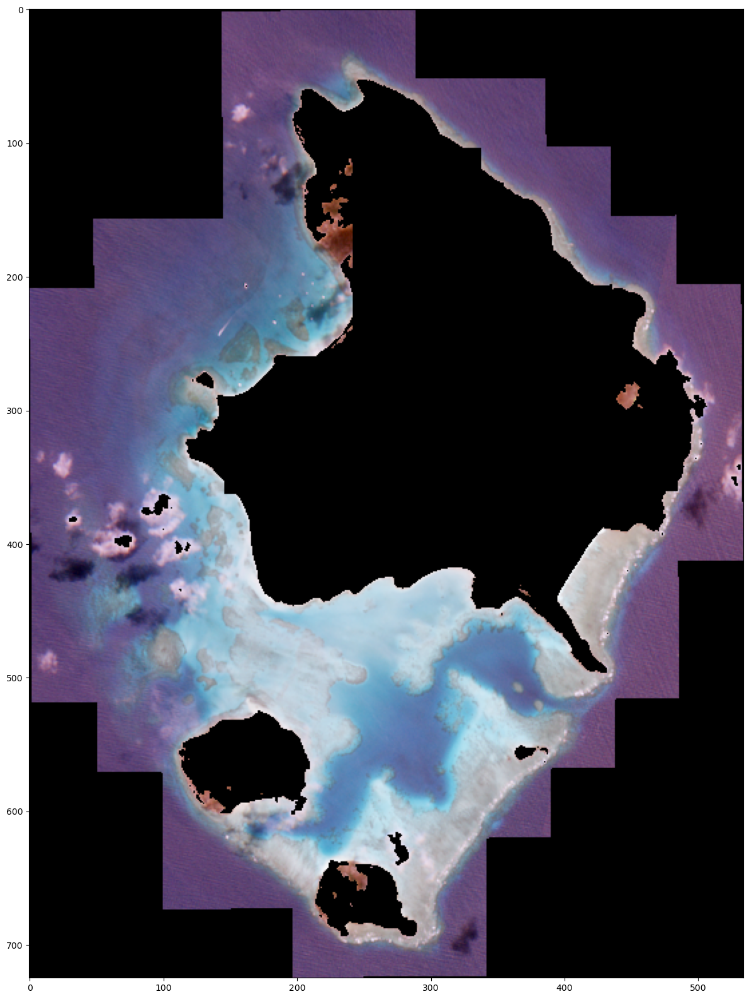

In [86]:
plt.figure(figsize=(20,20))
test_data, original_shape = reshape_stack(indice_stack[3])

ih.plot_rgb(np.array(test_data).reshape(original_shape[:2] + (len(sample_data.columns),)), plot= True)

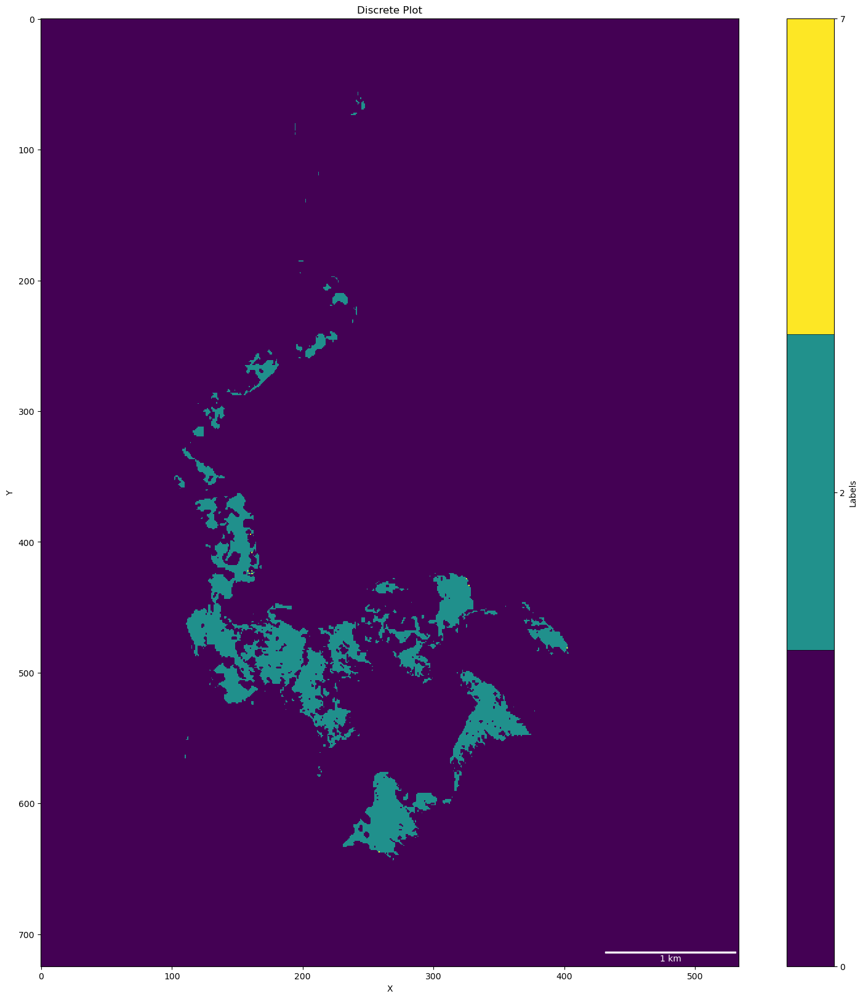

In [87]:
# plt.figure(figsize=(20,20))

test_data, original_shape = reshape_stack(indice_stack[4])
fig = ih.discrete_implot(bst.predict(test_data).reshape(original_shape[:2]), return_fig = True)
#set figure figsize using a fig object
fig.set_size_inches(20, 20)

In [88]:
test_data.shape

(387150, 14)

In [89]:
test_data, original_shape = reshape_stack(indice_stack[4])
prediction = ih.predict_mask(np.array(test_data).reshape(original_shape[:2] + (14,)), estimator = bst, mask_val = 7)

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator StandardScaler from version 1.1.3 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator PCA from version 1.1.3 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator KMeans from version 1.1.3 when using version 1.2.2. This might le

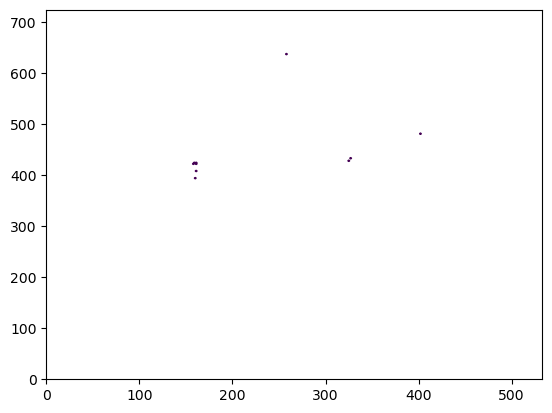

In [90]:
plt.contour(prediction, levels = [0.5])

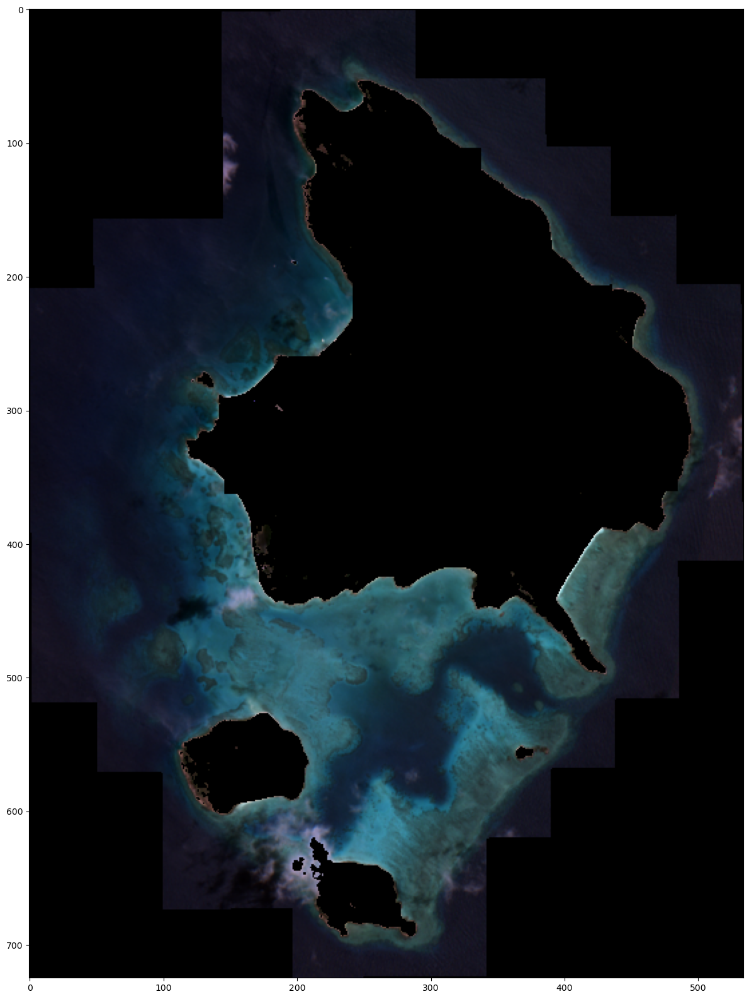

In [91]:
plt.figure(figsize=(20,20))

ih.plot_rgb(indice_stack[4], plot= True)

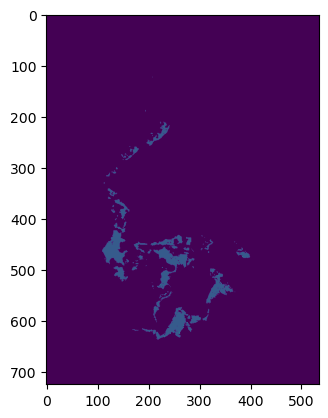

In [92]:
test_data, original_shape = reshape_stack(indice_stack[9])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

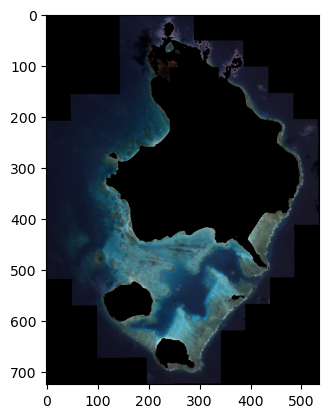

In [93]:
ih.plot_rgb(indice_stack[9], plot= True)

0.7987552656955793
0.3456459853919019


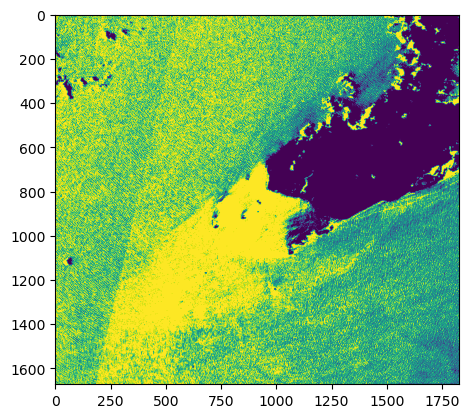

0.4009141191536836


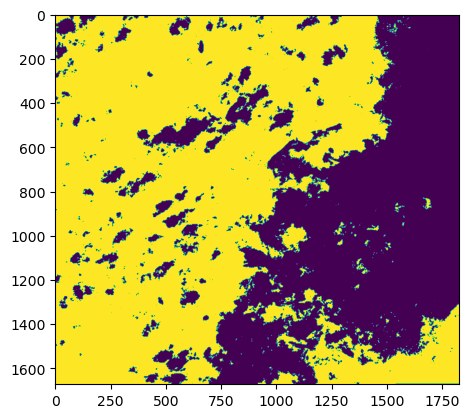

0.10494921996736879


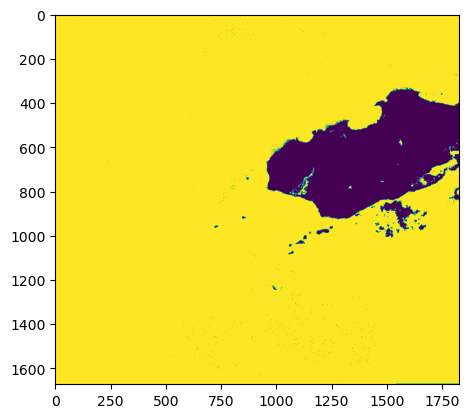

0.995418274002666
0.6838393899406182
0.13799552433853704


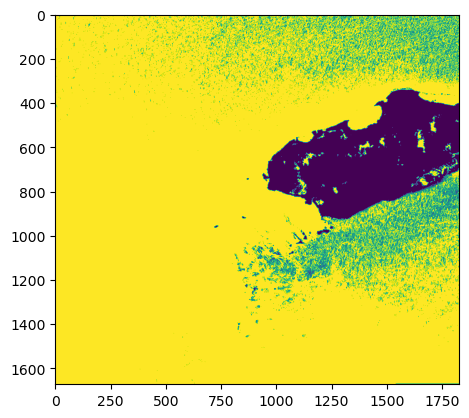

0.2243611903321522


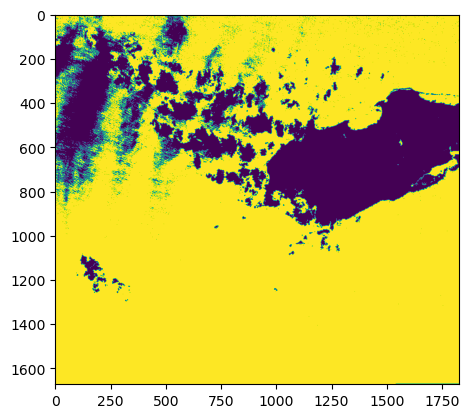

0.680347189860335
0.1936763783087947


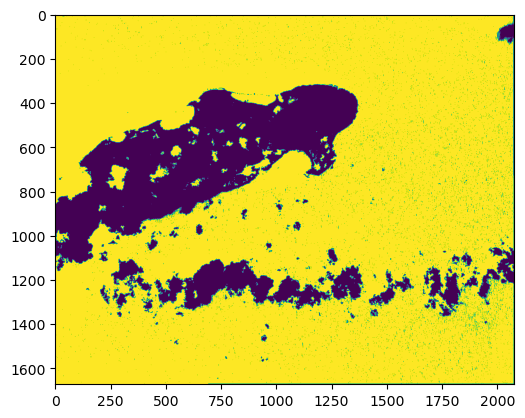

0.12012476180369394


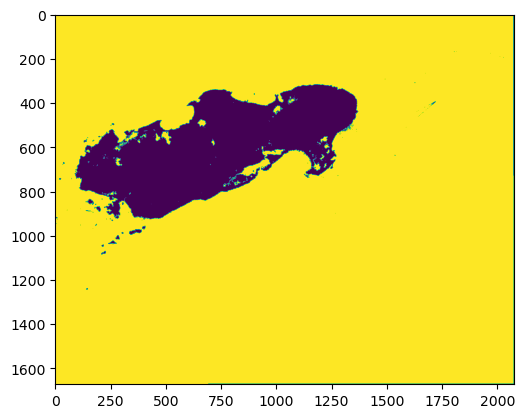

0.7092924971781596
0.09256945917562978


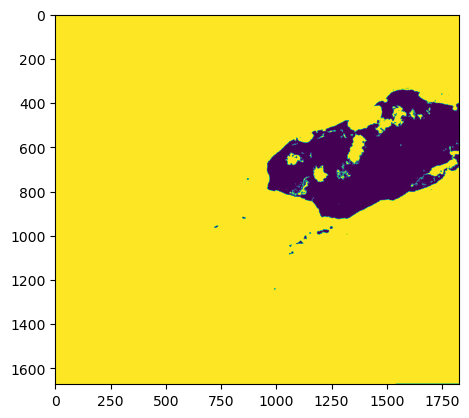

0.360938592562912


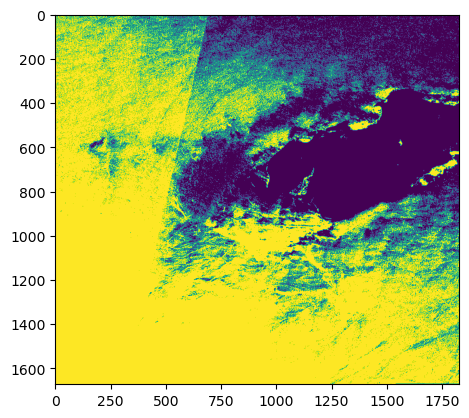

0.12473383148851351


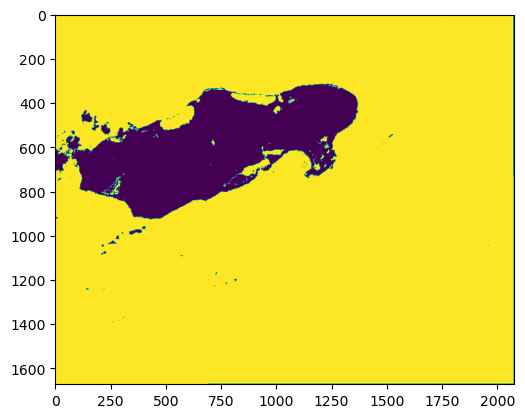

0.12476324556020542


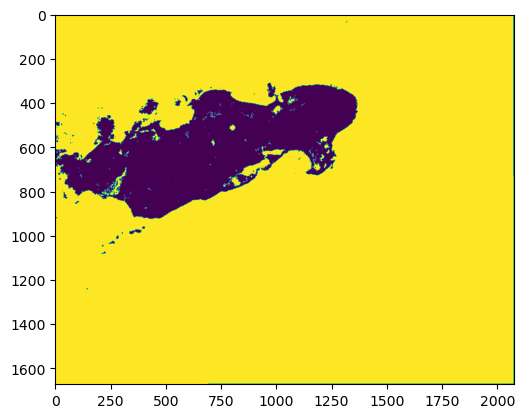

0.4735051307368975


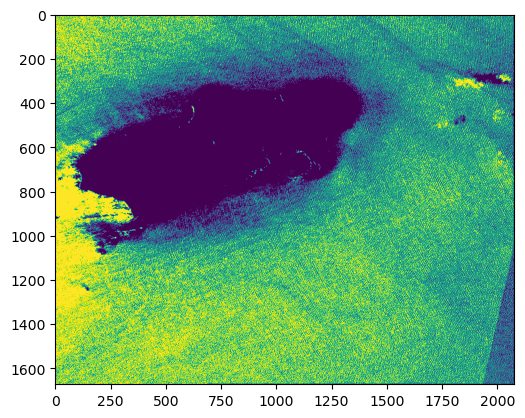

0.23528878361001773


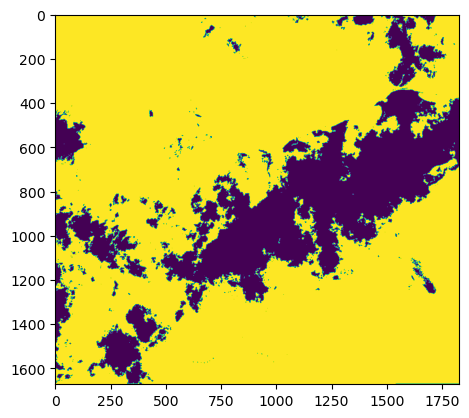

0.9229135041733377
0.9936999630738288
0.15964381958029872


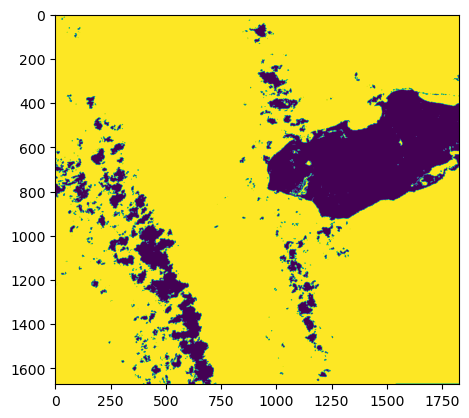

In [94]:
# data = ih.apply_mask(data, ~mask, fill_value=np.nan)
import os
import glob

# specify the directory path
dir_path = '/media/ziad/Expansion/Honduras_Clipped'

# search for all .tiff files in the directory
file_list = glob.glob(dir_path + '/*.tiff')

# get the full directory paths for each file
dir_list = [os.path.join(dir_path, f) for f in file_list]


masks = []
good_imagery = []
for i in range(len(dir_list)):
    data = load_img(dir_list[i])
    #plt.imshow(data[:,:,7])
    mask = Indices.mask_land(tf.LCE_multi(data),land_band= 'B08', threshold=15)
    mean = (np.mean(mask))
    print(mean)
    if np.mean(mask) < 0.5:
        masks.append(mask)
        good_imagery.append(data)
        plt.imshow(~mask)
        plt.show()
    if i == 20:
        break


In [95]:
clipped_imagery = []
for img, mask in zip(good_imagery, masks):
    clipped_imagery.append((ih.apply_mask(img, ~mask, fill_value=np.nan)))


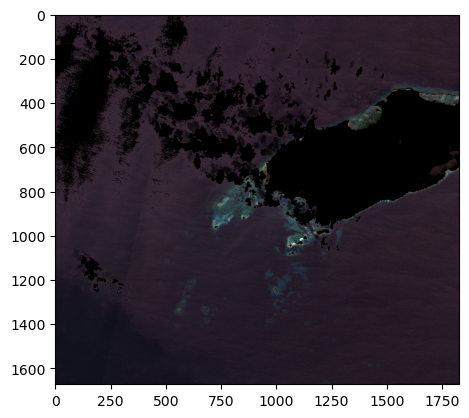

In [96]:
ih.plot_rgb(clipped_imagery[4], plot= True)

In [97]:
# features = GenerateIndicesPerImage(data)


indice_stack = []
for img in clipped_imagery:
    empty_arr = np.zeros(img[:,:,0].shape, dtype = np.float32)
    result_test = np.insert(img, 11, empty_arr, axis = 2)
    features = GenerateIndicesPerImage(result_test)
    concated_array = np.concatenate((result_test, features.indices), axis = 2)
    indice_stack.append(concated_array)

[('bgr', <function bgr at 0x7f7ea917e710>), ('calculate_pseudo_subsurface_depth', <function calculate_pseudo_subsurface_depth at 0x7f7ea917e9e0>), ('calculate_subsurface_depth', <function calculate_subsurface_depth at 0x7f7ea917ea70>), ('calculate_water_surface_index', <function calculate_water_surface_index at 0x7f7ea917e950>), ('ci', <function ci at 0x7f7f0813f010>), ('get_band_numbers', <function get_band_numbers at 0x7f7ea917e830>), ('mask_land', <function mask_land at 0x7f7ea917e7a0>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917e440>), ('ssi', <function ssi at 0x7f7ea917e4d0>), ('ti', <function ti at 0x7f7ea917e560>), ('validate_band_shape', <function validate_band_shape at 0x7f7ea917e8c0>), ('wqi', <function wqi at 0x7f7ea917e5f0>)]
[('bgr', <function bgr at 0x7f7ea917e710>), ('ci', <function ci at 0x7f7f0813f010>), ('ndci', <function ndci at 0x7f7ea917e680>), ('oci', <function oci at 0x7f7ea917e440>), ('ssi', <function ssi at 0x7f7ea917e4d0>)

In [98]:
imputer = SimpleImputer(strategy='mean')
imputer.fit(X_train)

SimpleImputer()

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


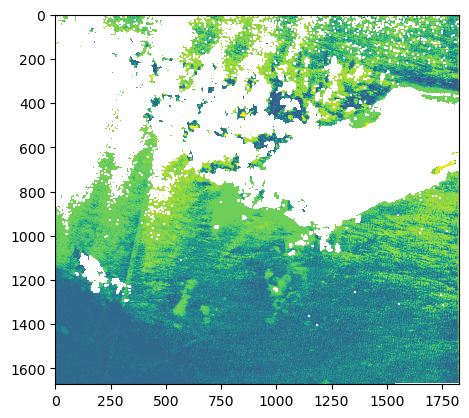

In [99]:
test_data, original_shape = reshape_stack(indice_stack[4])
nan_mask = np.isnan(indice_stack[4][:,:,0])

plt.imshow(ih.apply_mask(logreg.predict(imputer.transform(test_data)).reshape(original_shape[:2]), ~nan_mask, fill_value=np.nan))

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


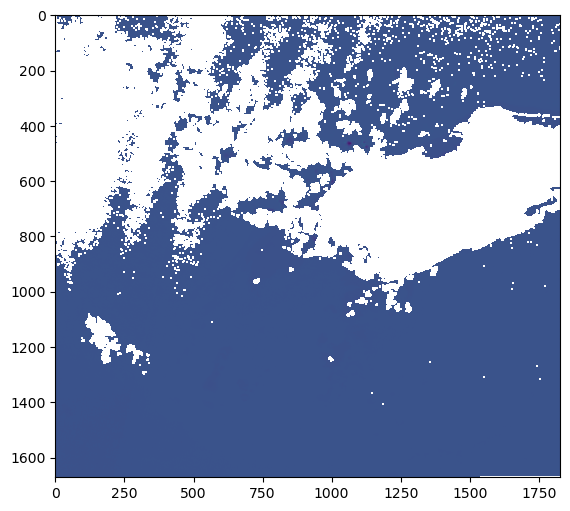

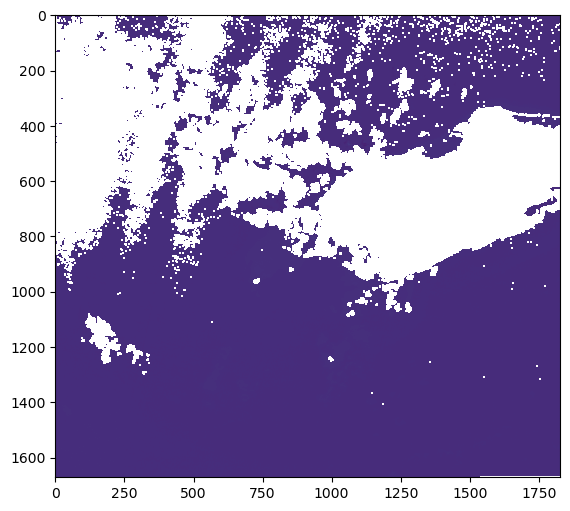

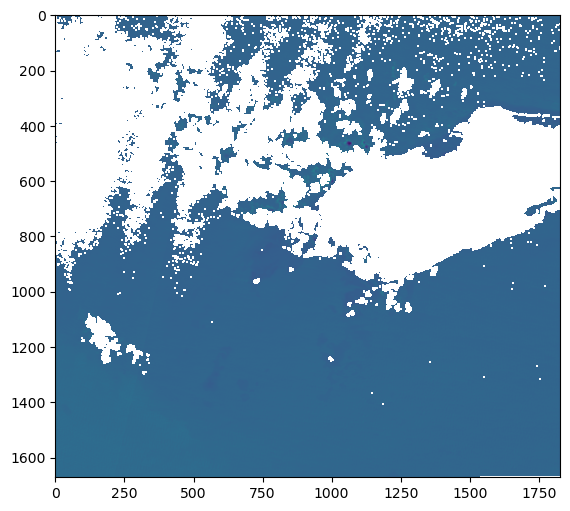

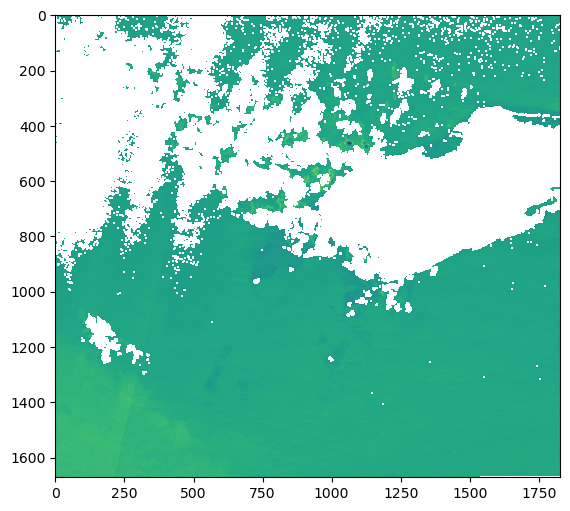

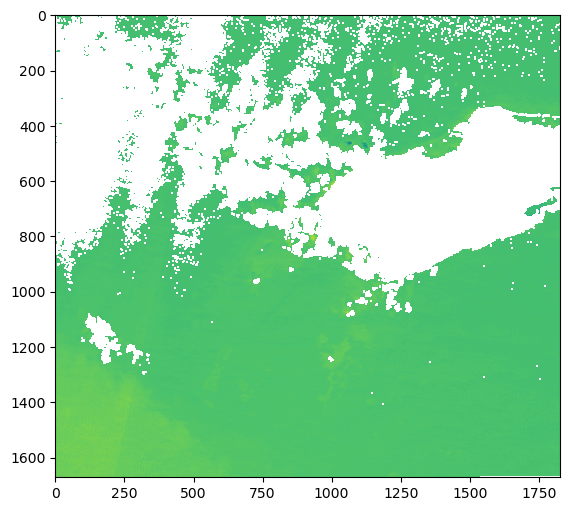

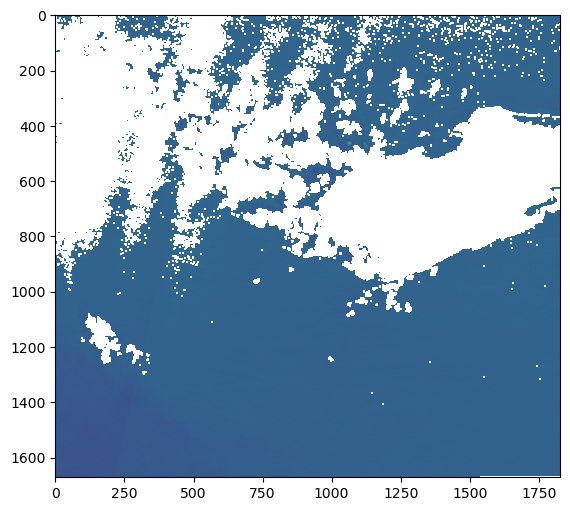

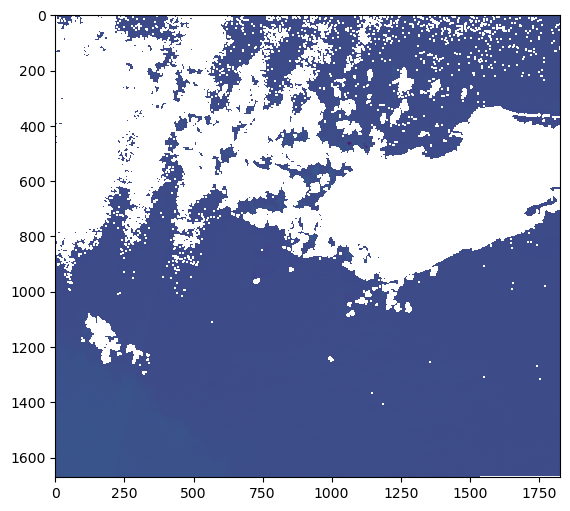

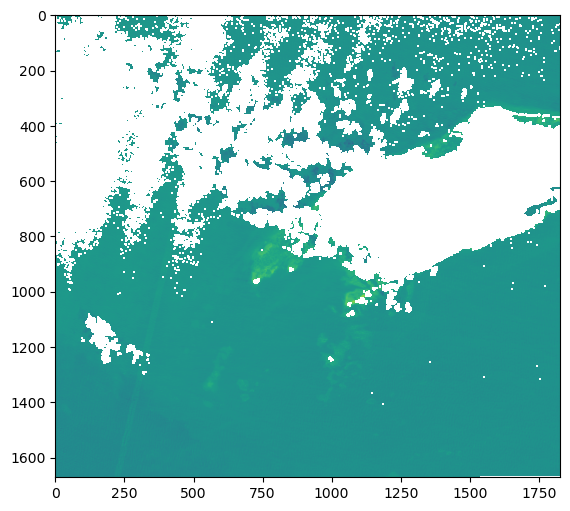

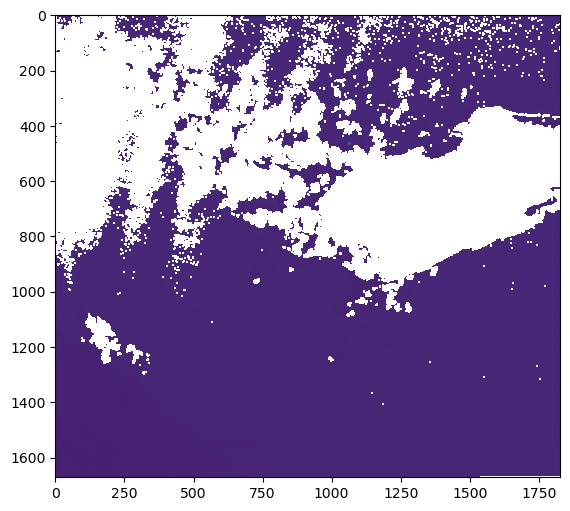

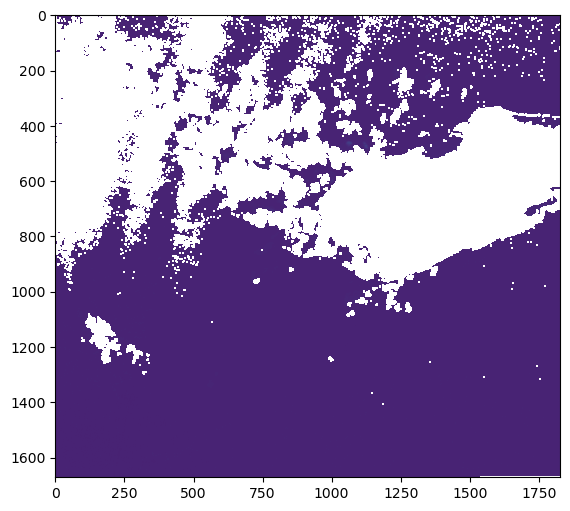

In [100]:
test_data, original_shape = reshape_stack(indice_stack[4])
nan_mask = np.expand_dims(np.isnan(indice_stack[4][:,:,0]), axis = 2)

probability_results = ih.apply_mask(logreg.predict_proba(imputer.transform(test_data)).reshape(original_shape[:2] +  (classes,)), ~nan_mask, fill_value=np.nan)
for i in range(classes):
    plt.figure(figsize=(8, 6))
    plt.imshow(probability_results[:,:,i])
    plt.show()

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


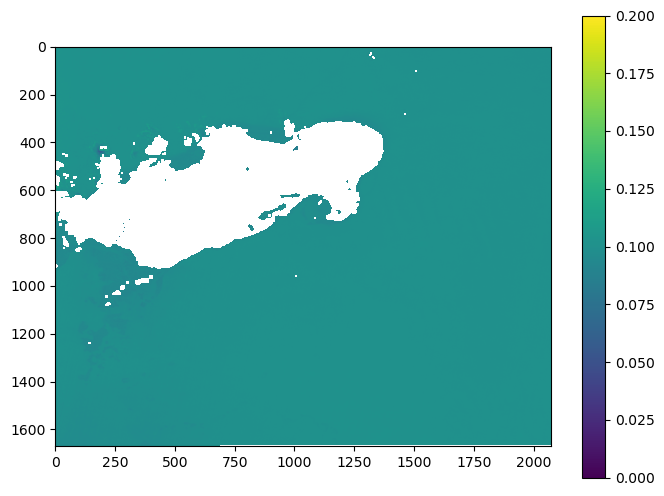

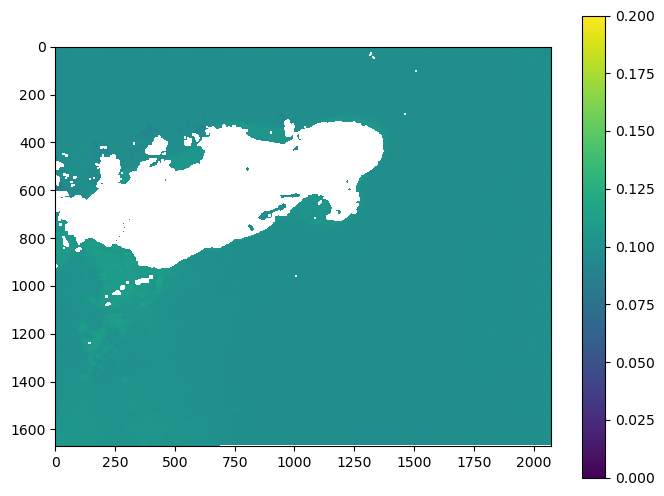

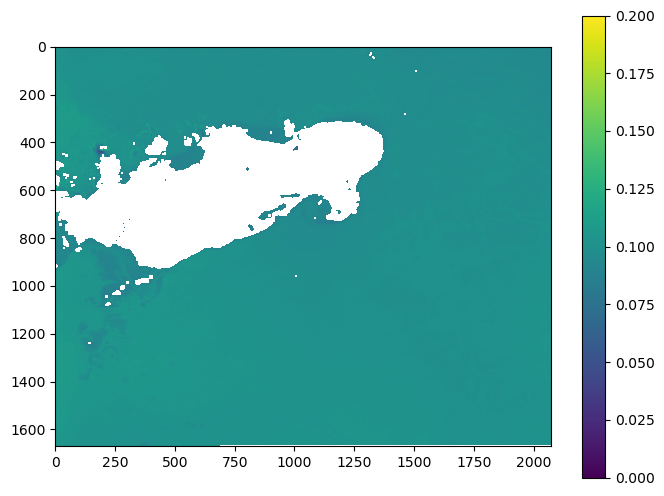

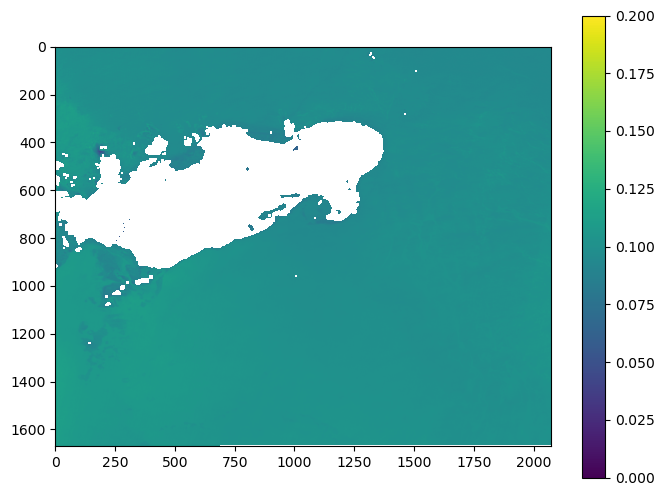

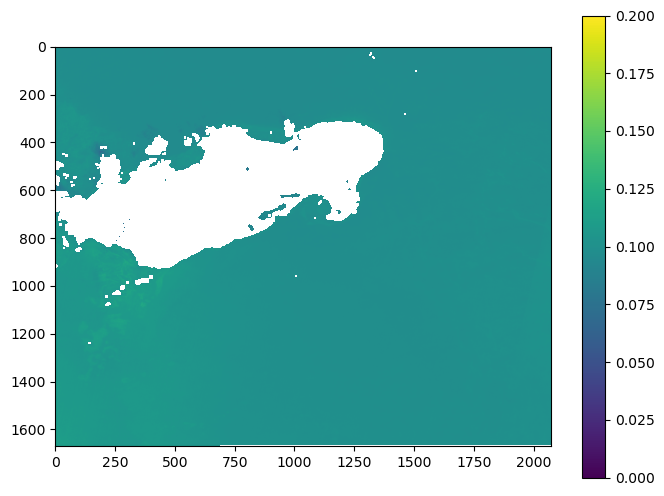

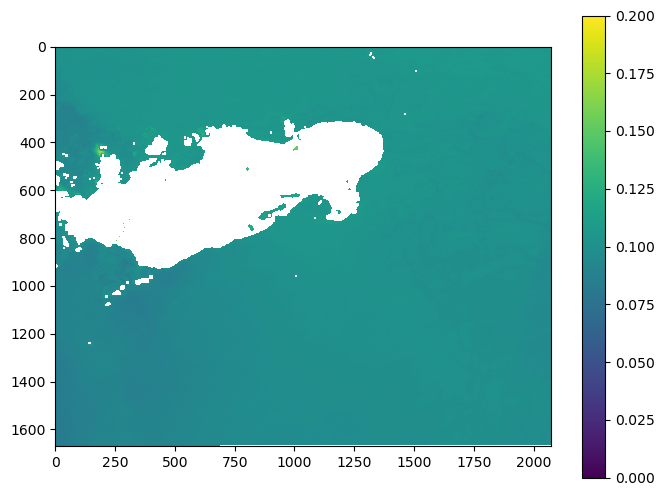

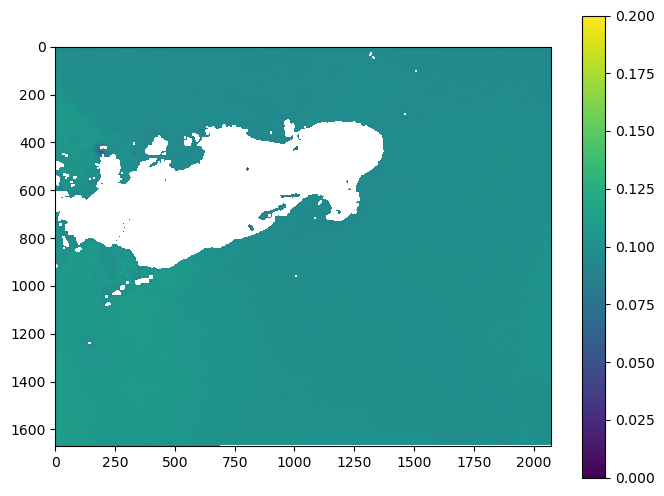

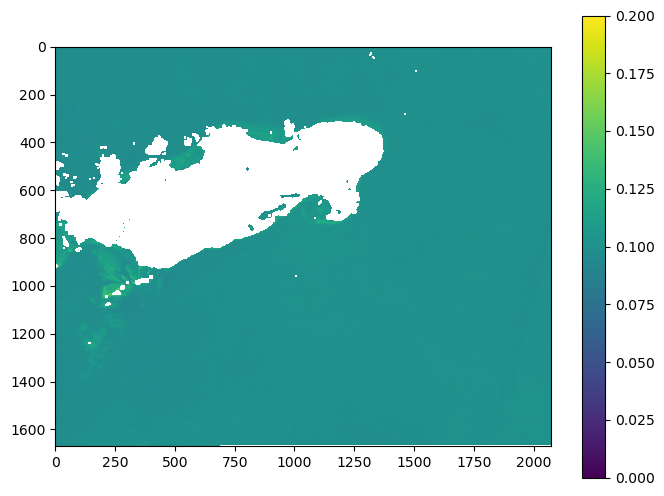

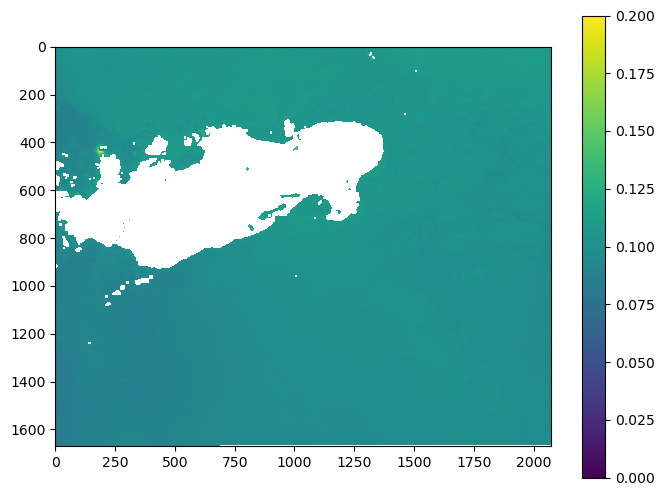

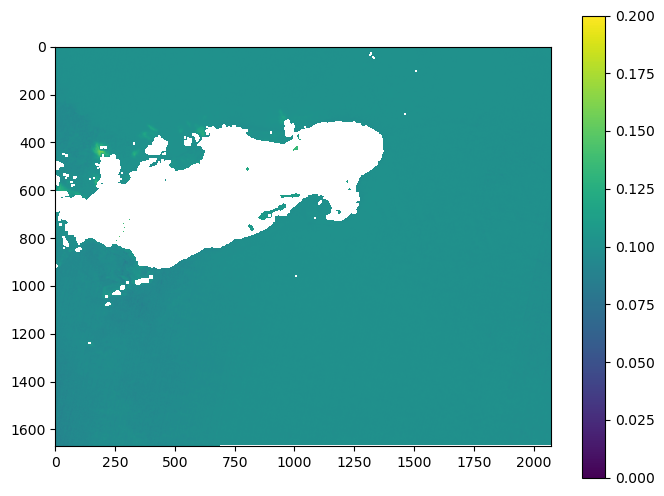

In [101]:
img_no = 10
test_data, original_shape = reshape_stack(indice_stack[img_no])
nan_mask = np.expand_dims(np.isnan(indice_stack[img_no][:,:,0]), axis = 2)

probability_results = ih.apply_mask(logreg.predict_proba(imputer.transform(test_data)).reshape(original_shape[:2] +  (classes,)), ~nan_mask, fill_value=np.nan)
for i in range(classes):
    plt.figure(figsize=(8, 6))
    plt.imshow(probability_results[:,:,i], vmin=0, vmax=0.2)
    plt.colorbar()
    plt.show()

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


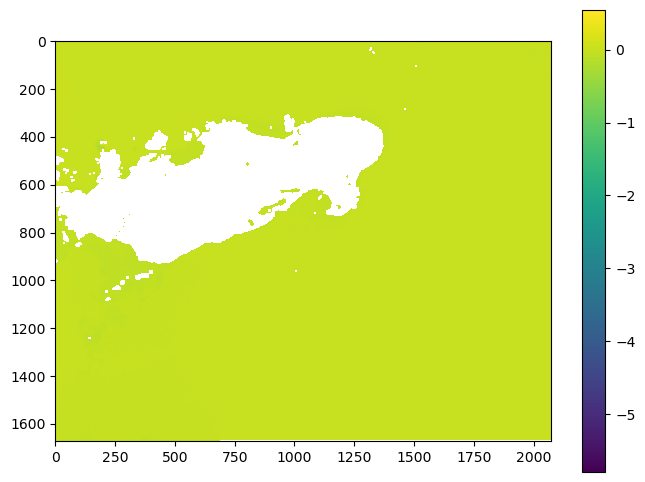

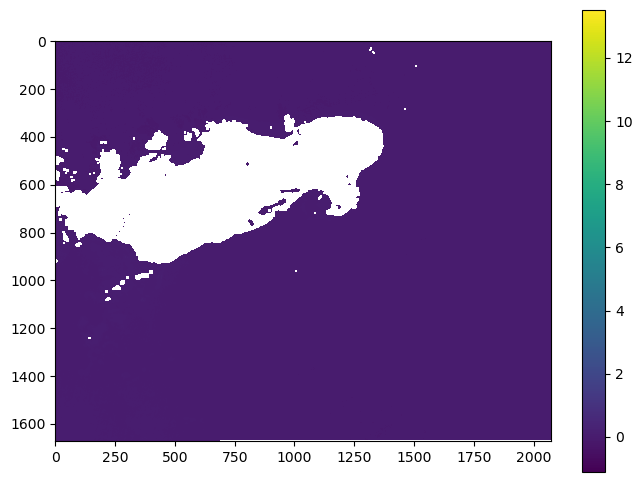

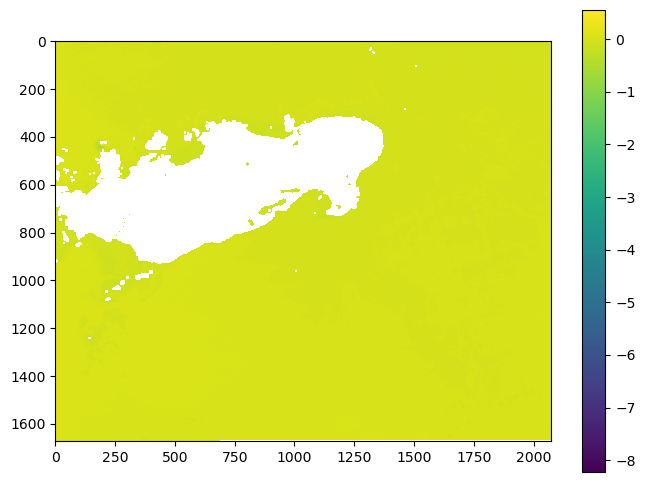

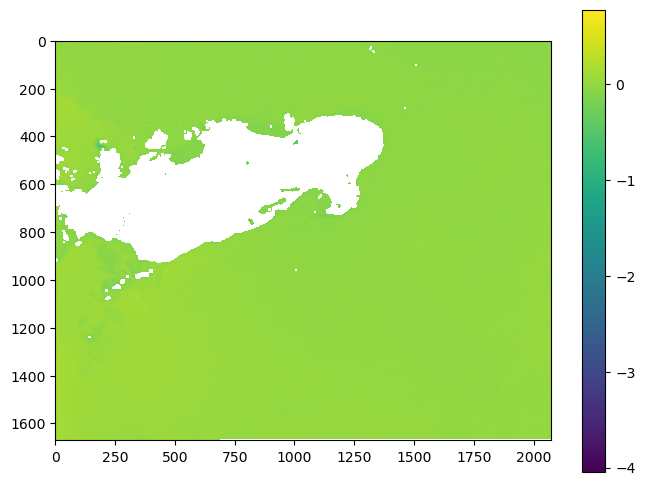

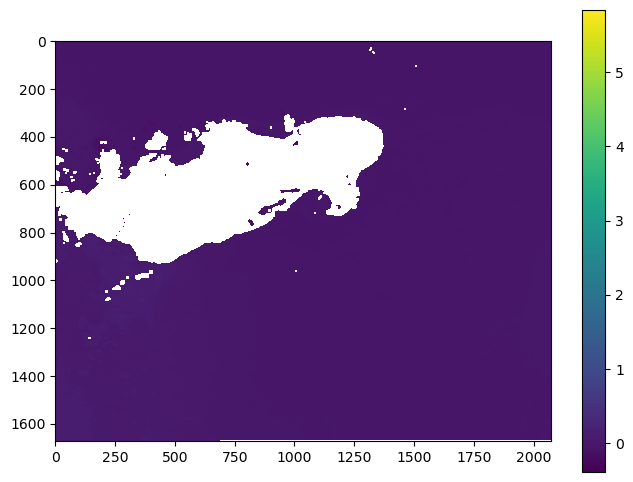

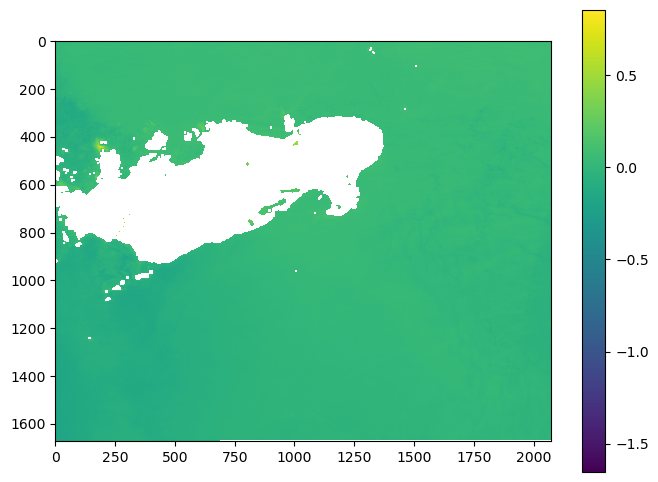

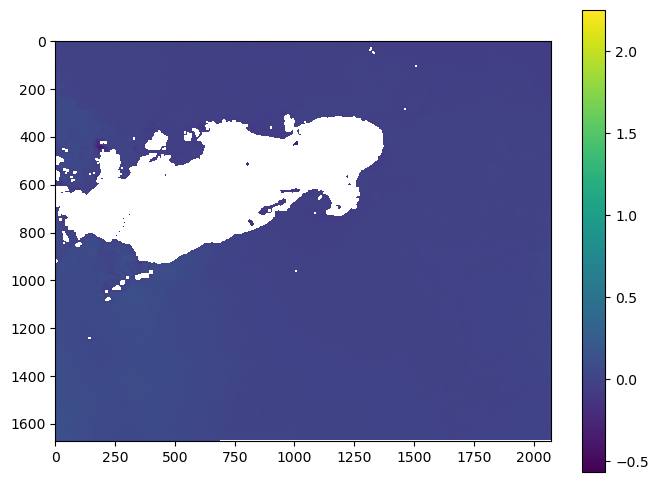

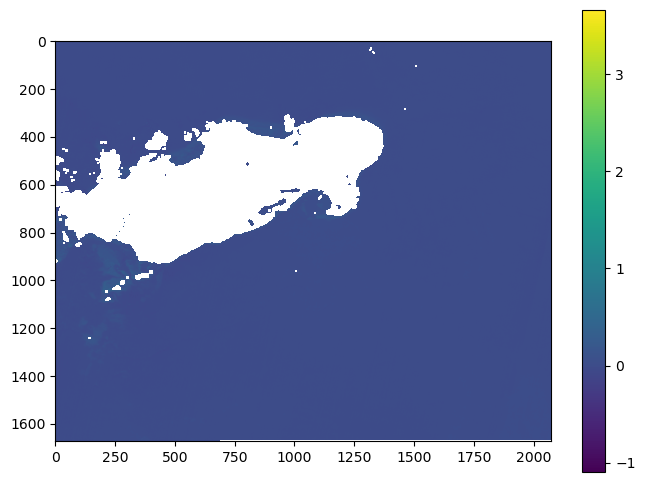

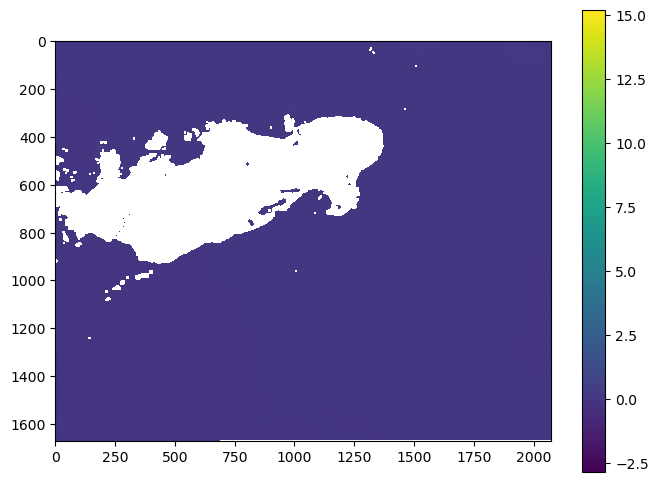

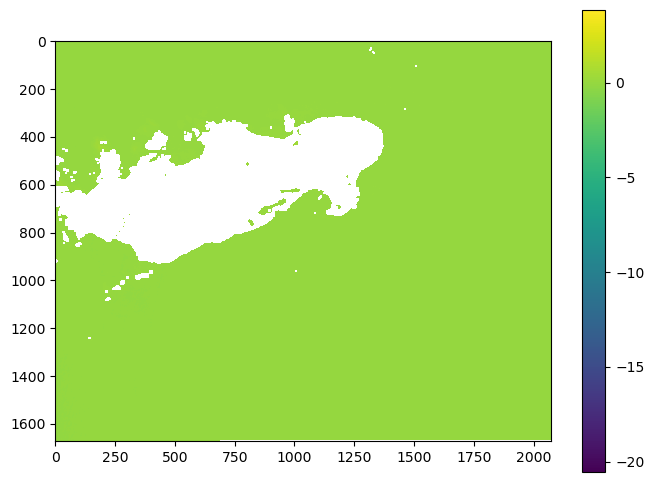

In [102]:
img_no = 10
test_data, original_shape = reshape_stack(indice_stack[img_no])
nan_mask = np.expand_dims(np.isnan(indice_stack[img_no][:,:,0]), axis = 2)

probability_results = ih.apply_mask(logreg.decision_function(imputer.transform(test_data)).reshape(original_shape[:2] +  (classes,)), ~nan_mask, fill_value=np.nan)
for i in range(classes):
    plt.figure(figsize=(8, 6))
    plt.imshow(probability_results[:,:,i])
    plt.colorbar()
    plt.show()

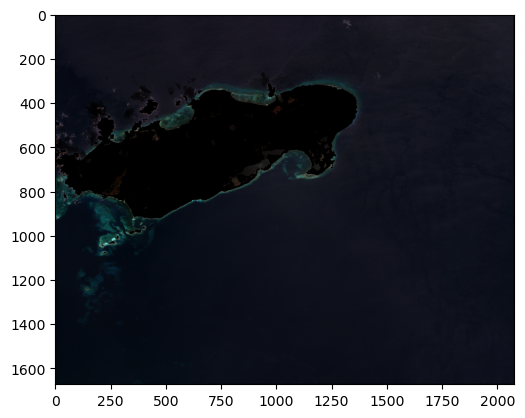

In [103]:
ih.plot_rgb(indice_stack[img_no], plot= True)

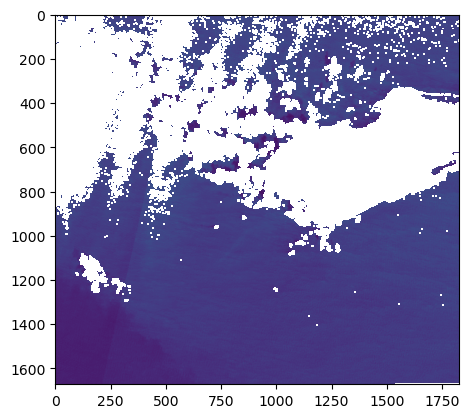

In [104]:
plt.imshow(indice_stack[4][:,:,8])

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


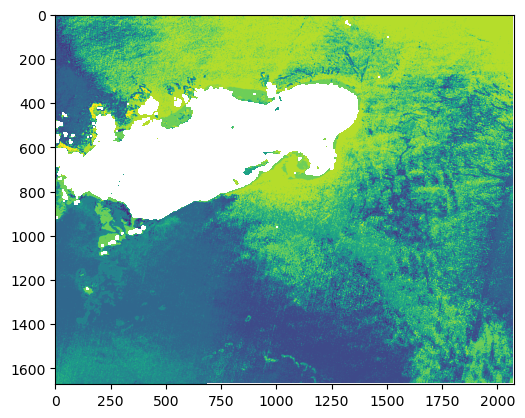

In [105]:
plt.imshow(ih.apply_mask(logreg.predict(imputer.transform(test_data)).reshape(original_shape[:2] + (1,)), ~nan_mask, fill_value=np.nan))

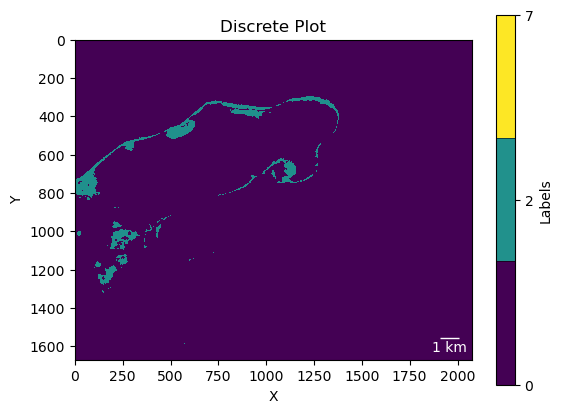

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


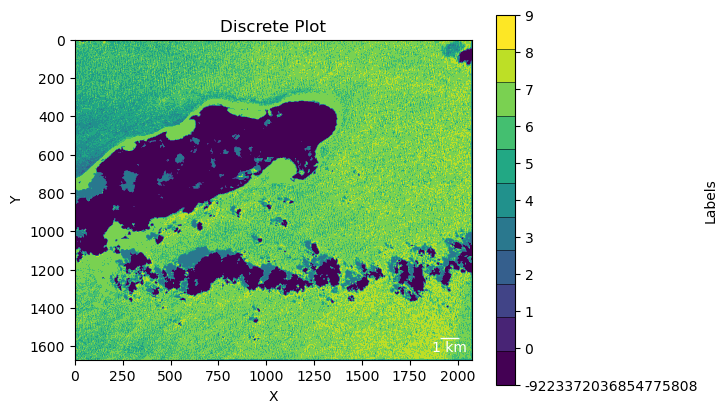

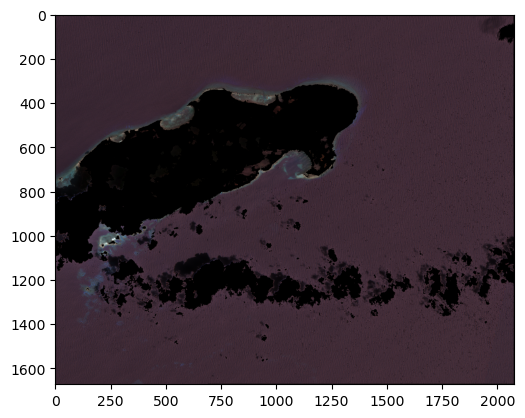

In [106]:
img_no = 5
test_data, original_shape = reshape_stack(indice_stack[img_no])
ih.discrete_implot(bst.predict(test_data).reshape(original_shape[:2]))
plt.show()
nan_mask = np.isnan(indice_stack[img_no][:,:,0])

ih.discrete_implot(ih.apply_mask(logreg.predict(imputer.transform(test_data)).reshape(original_shape[:2]), ~nan_mask, fill_value=np.nan).astype(int))
plt.show()
ih.plot_rgb(indice_stack[img_no], plot= True)

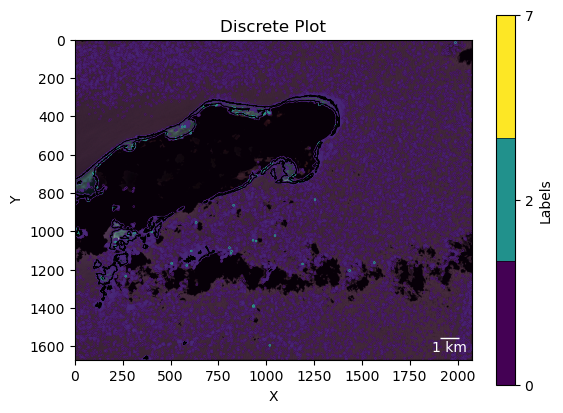

In [107]:
image = bst.predict(test_data).reshape(original_shape[:2])
ih.discrete_implot(image, return_fig = True)
ax = plt.gca()
rgb_img = ih.plot_rgb(indice_stack[img_no])
ax.imshow(rgb_img, alpha = 0.9)
contours = plt.contour(image, levels = range(classes))
min_area = 250
for collection in contours.collections:
    for path in collection.get_paths():
        extents = path.get_extents()
        area = extents.width * extents.height
        if area < min_area:
            continue
        plt.plot(*path.vertices.T, linewidth=0.5, color='black')
plt.gca().set_aspect('equal')

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


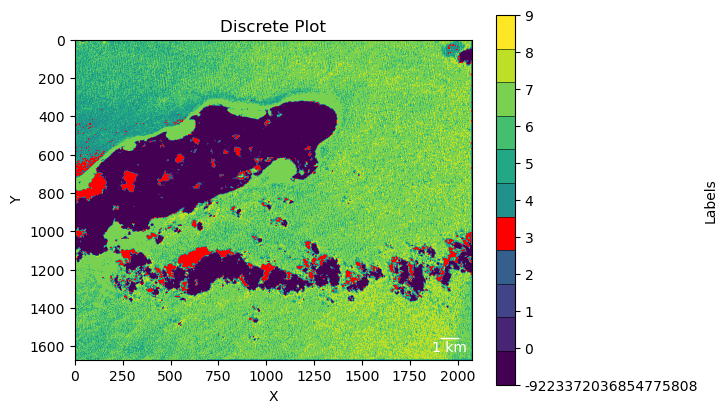

In [108]:
image = ih.apply_mask(logreg.predict(imputer.transform(test_data)).reshape(original_shape[:2]), ~nan_mask, fill_value=np.nan).astype(int)
ih.discrete_implot(image , change_labels=[3], change_colors=['red'])
# plt.contour(image, levels = range(classes))

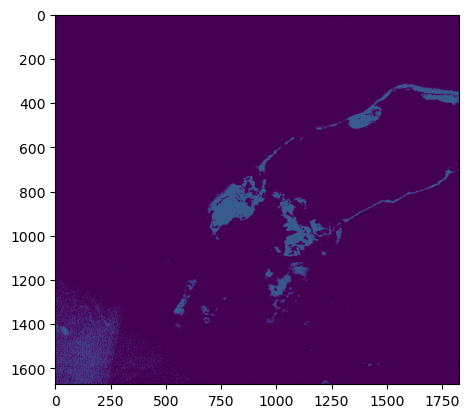

In [109]:
test_data, original_shape = reshape_stack(indice_stack[4])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

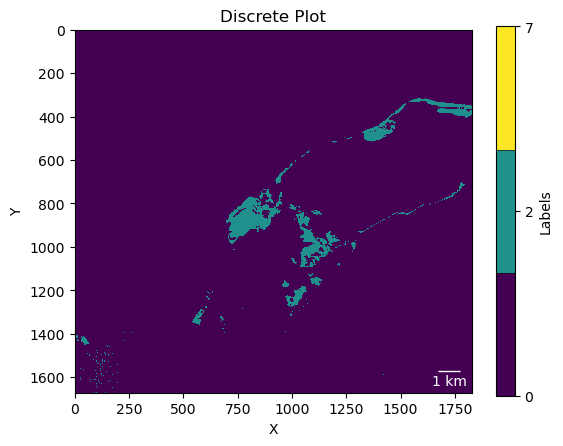

In [110]:
ih.discrete_implot(bst.predict(test_data).reshape(original_shape[:2]))

In [111]:
masked_reef = ih.apply_mask(np.array(test_data).reshape(original_shape[:2]+ (14,)), np.expand_dims(bst.predict(test_data).reshape(original_shape[:2]), axis = 2),  1)

In [112]:
mask = ih.predict_mask(np.array(test_data).reshape(original_shape[:2]+ (14,)), estimator = bst, mask_val = 8)

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator StandardScaler from version 1.1.3 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator PCA from version 1.1.3 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator KMeans from version 1.1.3 when using version 1.2.2. This might le

In [113]:
masked_reef = ih.apply_mask(np.array(test_data).reshape(original_shape[:2]+ (14,)), np.expand_dims(mask, axis = 2), fill_value = -999)

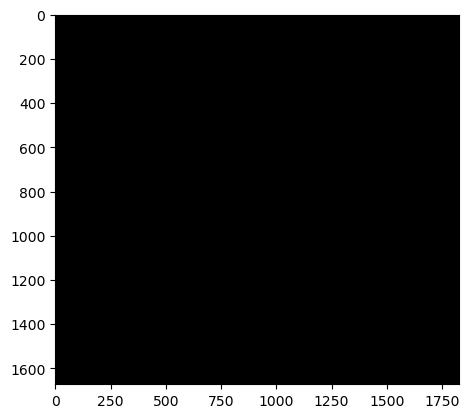

In [153]:
ih.plot_rgb(masked_reef, plot= True)

In [154]:
#import dbscan and apply to masked_reef
from sklearn.cluster import DBSCAN
from sklearn import metrics

# Compute DBSCAN
db = DBSCAN(eps=0.3, min_samples=10).fit(masked_reef.reshape(-1, 14))


: 

: 

In [ ]:
#replot the image with the clusters
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True


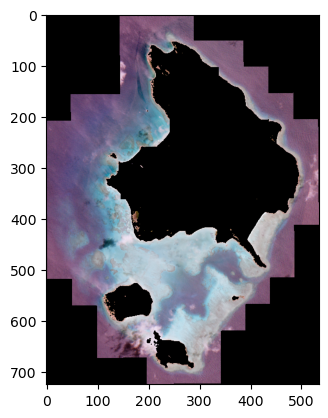

In [162]:
ih.plot_rgb(masked_reef, plot= True)

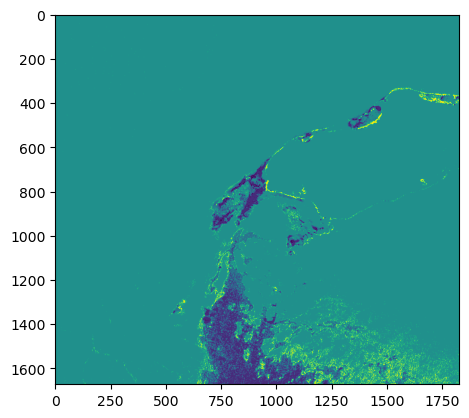

In [123]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

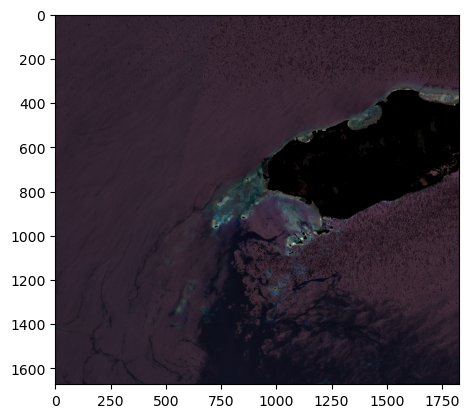

In [124]:
ih.plot_rgb(indice_stack[3], plot= True)

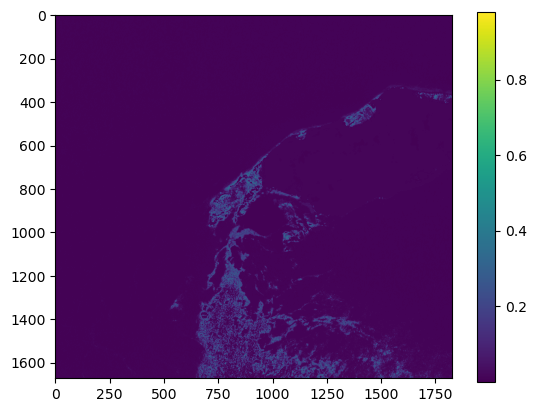

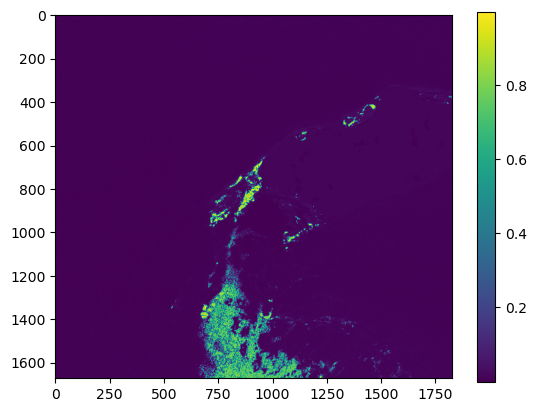

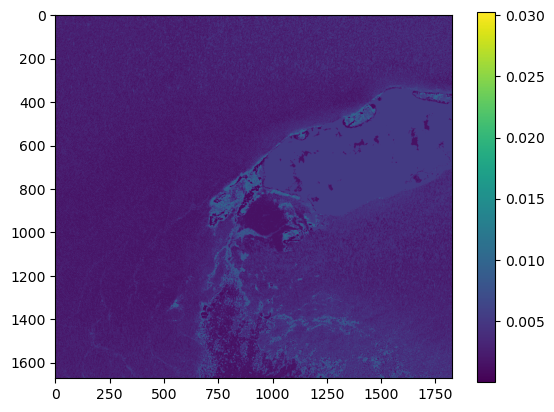

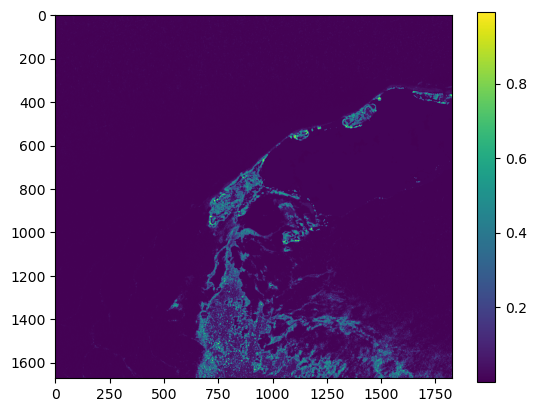

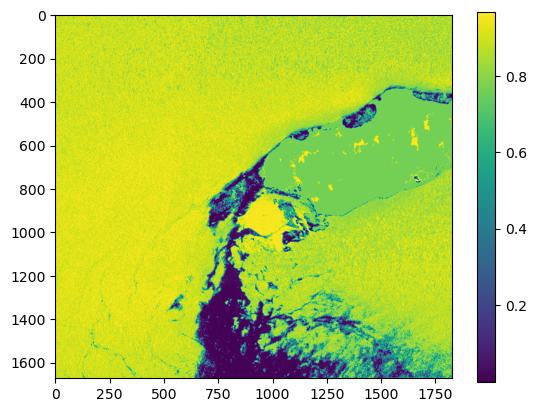

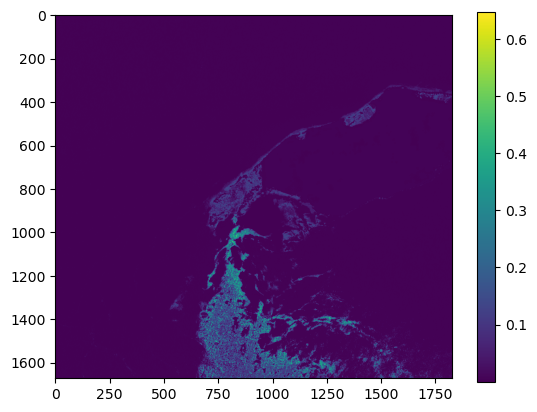

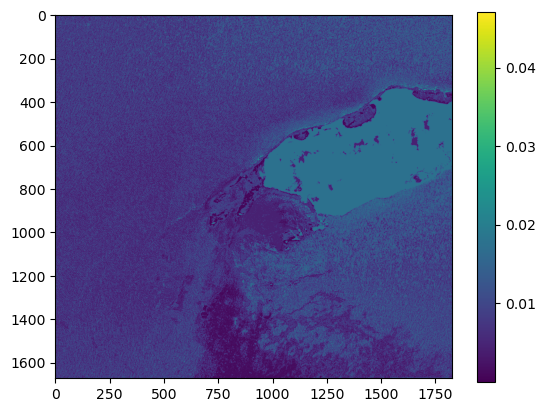

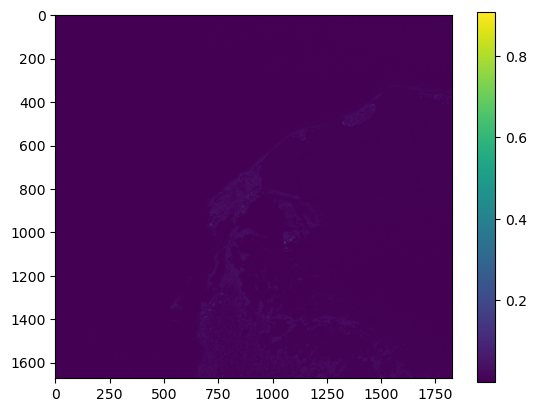

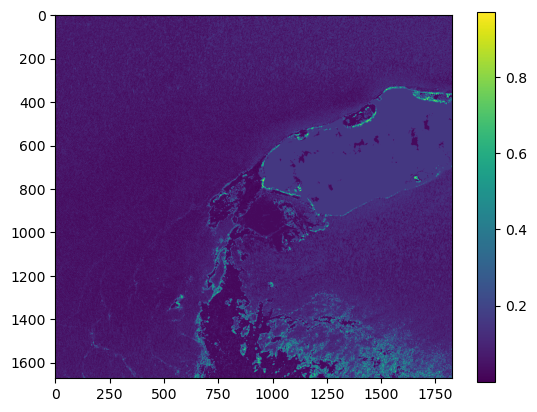

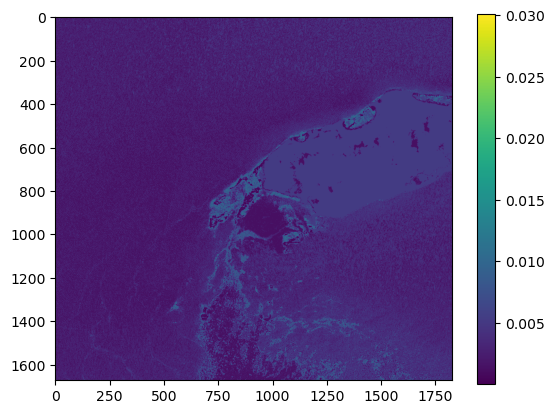

In [125]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))
for i in range(classes):
    plt.imshow(proba_[:,:,i])
    plt.colorbar()
    plt.show()

In [210]:
!pip install graphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 3.8 MB/s eta 0:00:00


In [224]:
import shap

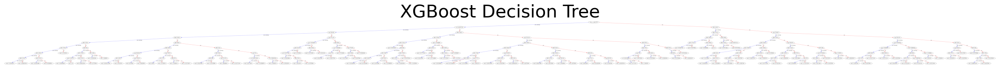

In [222]:
from xgboost import plot_tree
import matplotlib.pyplot as plt

# Visualize the first decision tree in the ensemble
fig, ax = plt.subplots(figsize=(30, 20))
plot_tree(bst, num_trees=1, ax=ax)

# Customize the plot
ax.set_title('XGBoost Decision Tree', fontsize=30)
ax.set_xlabel('Feature', fontsize=20)
ax.set_ylabel('Split Value', fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)
ax.tick_params(axis='both', which='minor', labelsize=14)
ax.set_facecolor('#f0f0f0')

# Show the plot
plt.savefig('../Graphs/decision_tree.pdf', dpi = 500)


In [227]:
explainer = shap.TreeExplainer(bst, feature_names=feature_names)

In [228]:
shap_explainer_values = explainer(X_test, y_test)

In [328]:
dir(shap_explainer_values)

['__add__',
 '__class__',
 '__copy__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__mul__',
 '__ne__',
 '__new__',
 '__radd__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rmul__',
 '__rsub__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__sub__',
 '__subclasshook__',
 '__truediv__',
 '__weakref__',
 '_apply_binary_operator',
 '_flatten_feature_names',
 '_numpy_func',
 '_s',
 '_use_data_as_feature_names',
 'abs',
 'argsort',
 'base_values',
 'clustering',
 'cohorts',
 'compute_time',
 'data',
 'display_data',
 'error_std',
 'feature_names',
 'flip',
 'hclust',
 'hierarchical_values',
 'hstack',
 'identity',
 'instance_names',
 'lower_bounds',
 'main_effects',
 'max',
 'mean',
 'min',
 'op_history',
 'output_dims',
 'output_indexes',
 'output_names',
 'percentile',
 'sample',
 'shape',
 's

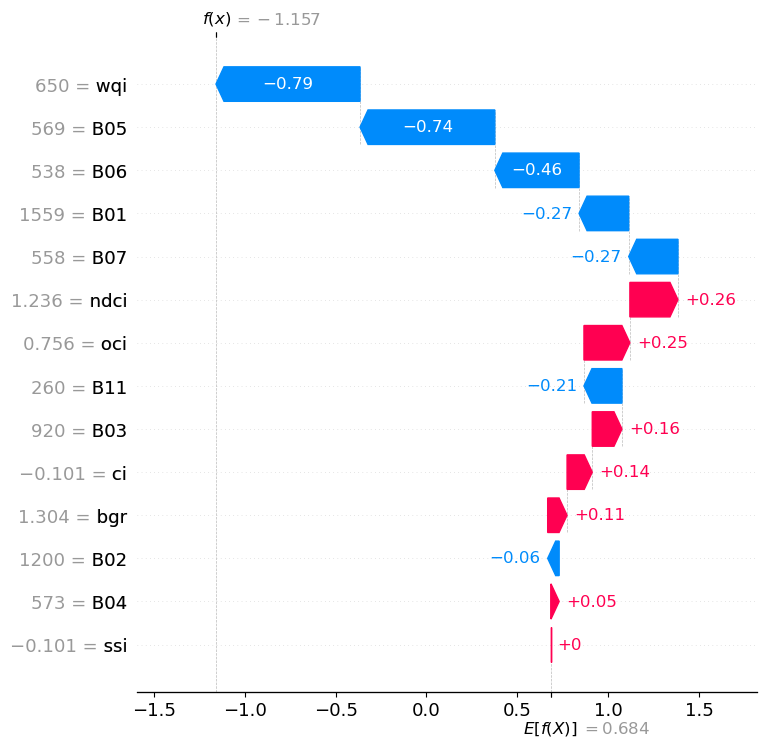

In [314]:
shap.plots.waterfall(shap_explainer_values[0,:,0], max_display=15)

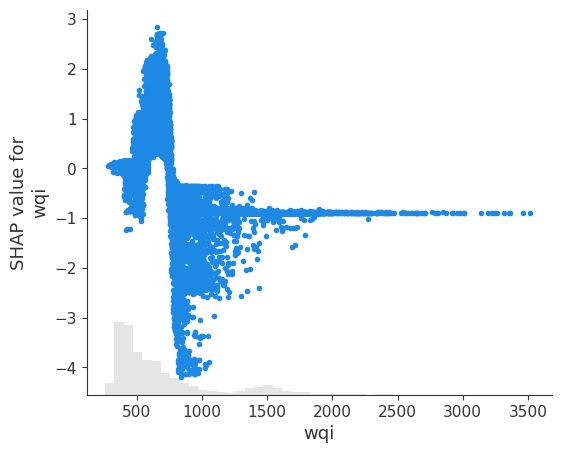

In [325]:
shap.plots.scatter(shap_explainer_values[:,"wqi",1])

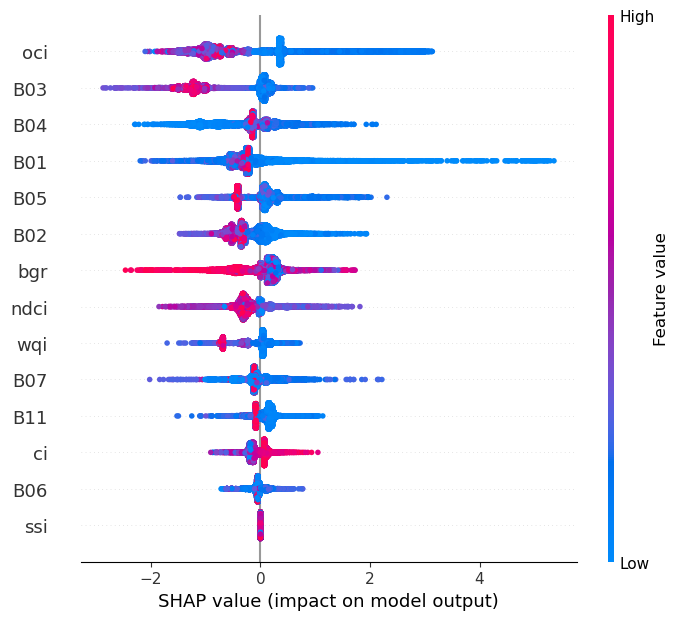

In [335]:
shap.plots.beeswarm(shap_explainer_values[:,:,0], max_display=15)

In [337]:
shap.plots.heatmap(shap_explainer_values[:,:,0])

(array([ 20120., 226196., 118612., 120260., 245299., 585645., 611119.,
        359450., 213633., 132869.]),
 array([  1. ,  75.4, 149.8, 224.2, 298.6, 373. , 447.4, 521.8, 596.2,
        670.6, 745. ]),
 <BarContainer object of 10 artists>)

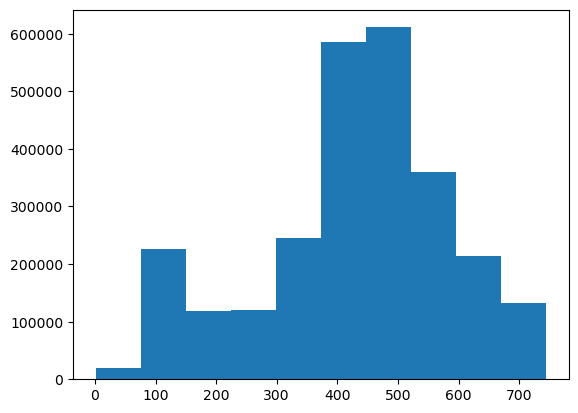

In [175]:
plt.hist(indice_stack[3][:,:,7].reshape(-1,1))

In [176]:
path = "/media/ziad/Expansion/London/"

In [177]:
directories = os.listdir(path)

In [178]:
directories

['S2A_MSIL2A_20230610T110621_N0509_R137_T30UXC_20230610T165306.zip.tiff']

In [179]:
london = load_img(path + directories[0])

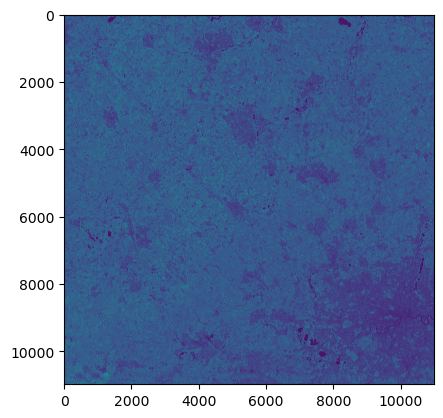

In [ ]:
plt.imshow(london[:,:,7])

In [292]:
mask = Indices.mask_land(tf.LCE_multi(london),land_band= 'B08', threshold=20)

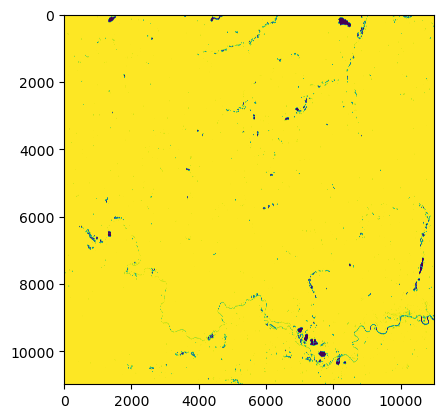

In [293]:
plt.imshow(mask)

In [197]:
masked_london = ih.apply_mask(london, ~mask, fill_value=np.nan)

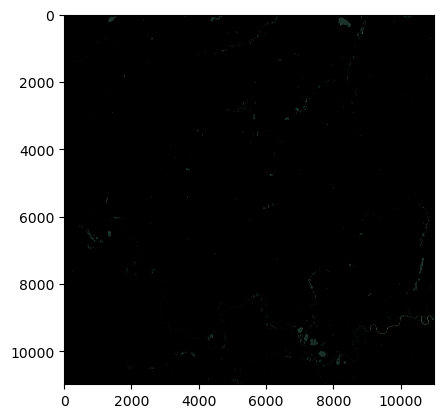

In [198]:
ih.plot_rgb(masked_london, plot= True)

In [199]:
# features = GenerateIndicesPerImage(data)

empty_arr = np.zeros(masked_london[:,:,0].shape, dtype = np.float32)
result_test = np.insert(masked_london, 11, empty_arr, axis = 2)
features = GenerateIndicesPerImage(result_test)
concated_array = np.concatenate((result_test, features.indices), axis = 2)


[('bgr', <function bgr at 0x7f28e3d6ee60>), ('ci', <function ci at 0x7f28e3d6f880>), ('get_band_numbers', <function get_band_numbers at 0x7f28e3d880d0>), ('mask_land', <function mask_land at 0x7f28e3d6eb00>), ('ndci', <function ndci at 0x7f28e3d6e320>), ('oci', <function oci at 0x7f28e3d6c160>), ('ssi', <function ssi at 0x7f28e3d6d090>), ('ti', <function ti at 0x7f28e3d6ca60>), ('validate_band_shape', <function validate_band_shape at 0x7f28e3d895a0>), ('wqi', <function wqi at 0x7f28e3d6edd0>)]
[('bgr', <function bgr at 0x7f28e3d6ee60>), ('ci', <function ci at 0x7f28e3d6f880>), ('ndci', <function ndci at 0x7f28e3d6e320>), ('oci', <function oci at 0x7f28e3d6c160>), ('ssi', <function ssi at 0x7f28e3d6d090>), ('ti', <function ti at 0x7f28e3d6ca60>), ('wqi', <function wqi at 0x7f28e3d6edd0>)]


: 

: 

In [ ]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

In [ ]:
#put arrows on the - make it clear - explain the processing multistep scaling -histograms 1,2,3 with intermediate steps / big arrow towards first spectra make process clear - workflow 

# add scales for the observationdate vs average - with two axis - two different scales try different clusters maybe something there 